# Evaluación YOLOv11 en Test Set

Este notebook permite evaluar y visualizar las predicciones del modelo YOLOv11 en el dataset de test.

## Funcionalidades:
- Cargar el mejor modelo YOLOv11 entrenado
- Evaluar en todo el dataset de test
- Visualizar predicciones con bounding boxes
- Comparar predicciones vs ground truth
- Analizar métricas de detección por clase
- **Seleccionar y visualizar los peores casos**
- **Configurar thresholds (confidence, IoU) dinámicamente**
- Visualizar casos aleatorios del dataset

In [3]:
import sys
import json
import random
from pathlib import Path
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np
import pandas as pd
from PIL import Image
import cv2
from collections import defaultdict
import yaml

from ultralytics import YOLO

# Add src to path
sys.path.append(str(Path.cwd().parent.parent))

print("Libraries imported successfully!")

Libraries imported successfully!


## 1. Configuración y Carga del Modelo

In [4]:
# ============================================================================
# CONFIGURACIÓN PRINCIPAL - Modificar según necesites
# ============================================================================

# Project paths
PROJECT_ROOT = Path.cwd().parent.parent
DATA_DIR = PROJECT_ROOT / 'data' / 'yolo'

# Model selection - CAMBIAR AQUÍ PARA USAR OTRO MODELO
# Opciones disponibles en runs/detect/
MODEL_RUN = 'taco_detection_yolo11l_23c_aug_p100'  # Cambia esto por tu experimento

RUNS_DIR = PROJECT_ROOT / 'runs' / 'detect'
MODEL_DIR = RUNS_DIR / MODEL_RUN
BEST_WEIGHTS = MODEL_DIR / 'weights' / 'best.pt'

# ============================================================================
# PARÁMETROS DE EVALUACIÓN - Ajustar para experimentar
# ============================================================================

# Detection thresholds
CONF_THRESHOLD = 0.25  # Confidence threshold (0.0 - 1.0)
IOU_THRESHOLD = 0.45   # IoU threshold for NMS (0.0 - 1.0)

# Visualization settings
IMG_SIZE = 640         # Image size for inference
MAX_DET = 300          # Maximum detections per image

# Analysis settings
NUM_WORST_CASES = 20   # Number of worst cases to analyze
NUM_RANDOM_SAMPLES = 10  # Number of random samples to show

print(f"Project root: {PROJECT_ROOT}")
print(f"Data directory: {DATA_DIR}")
print(f"Model: {MODEL_RUN}")
print(f"Weights: {BEST_WEIGHTS.name}")
print(f"\nEvaluation parameters:")
print(f"  Confidence threshold: {CONF_THRESHOLD}")
print(f"  IoU threshold: {IOU_THRESHOLD}")
print(f"  Image size: {IMG_SIZE}")

Project root: /home/rodrigo/Desktop/maestria/trash-detection
Data directory: /home/rodrigo/Desktop/maestria/trash-detection/data/yolo
Model: taco_detection_yolo11l_23c_aug_p100
Weights: best.pt

Evaluation parameters:
  Confidence threshold: 0.25
  IoU threshold: 0.45
  Image size: 640


In [5]:
# Load data.yaml to get class names
data_yaml_path = DATA_DIR / 'data.yaml'

with open(data_yaml_path, 'r') as f:
    data_config = yaml.safe_load(f)

CLASS_NAMES = data_config['names']
NUM_CLASSES = data_config['nc']

print(f"Number of classes: {NUM_CLASSES}")
print(f"\nClass names:")
for idx, name in enumerate(CLASS_NAMES):
    print(f"  {idx}: {name}")

Number of classes: 23

Class names:
  0: Aluminium foil
  1: Other plastic bottle
  2: Clear plastic bottle
  3: Glass bottle
  4: Plastic bottle cap
  5: Metal bottle cap
  6: Broken glass
  7: Drink can
  8: Other carton
  9: Corrugated carton
  10: Paper cup
  11: Disposable plastic cup
  12: Plastic lid
  13: Other plastic
  14: Normal paper
  15: Plastic film
  16: Other plastic wrapper
  17: Single-use carrier bag
  18: Pop tab
  19: Plastic straw
  20: Styrofoam piece
  21: Unlabeled litter
  22: Cigarette


In [6]:
# Load the YOLO model
print(f"Loading model from: {BEST_WEIGHTS}")

if not BEST_WEIGHTS.exists():
    raise FileNotFoundError(f"Model weights not found at {BEST_WEIGHTS}")

model = YOLO(str(BEST_WEIGHTS))

print(f"Model loaded successfully!")
print(f"Model type: {model.model.__class__.__name__}")

Loading model from: /home/rodrigo/Desktop/maestria/trash-detection/runs/detect/taco_detection_yolo11l_23c_aug_p100/weights/best.pt
Model loaded successfully!
Model type: DetectionModel


## 2. Cargar Dataset de Test

In [7]:
# Get test images and labels
test_images_dir = DATA_DIR / 'test' / 'images'
test_labels_dir = DATA_DIR / 'test' / 'labels'

test_images = sorted(list(test_images_dir.glob('*.jpg')))
print(f"Found {len(test_images)} test images")

# Show sample paths
if test_images:
    print(f"\nSample image: {test_images[0].name}")
    sample_label = test_labels_dir / f"{test_images[0].stem}.txt"
    print(f"Sample label: {sample_label.name}")
    print(f"Label exists: {sample_label.exists()}")

Found 629 test images

Sample image: batch_10_000000.jpg
Sample label: batch_10_000000.txt
Label exists: True


## 3. Funciones de Utilidad

In [8]:
def load_yolo_labels(label_path, img_width, img_height):
    """
    Load YOLO format labels and convert to absolute coordinates
    
    Args:
        label_path: Path to label file
        img_width: Image width
        img_height: Image height
        
    Returns:
        List of [class_id, x1, y1, x2, y2] boxes
    """
    boxes = []
    
    if not label_path.exists():
        return boxes
    
    with open(label_path, 'r') as f:
        for line in f:
            parts = line.strip().split()
            if len(parts) != 5:
                continue
            
            class_id = int(parts[0])
            x_center = float(parts[1]) * img_width
            y_center = float(parts[2]) * img_height
            width = float(parts[3]) * img_width
            height = float(parts[4]) * img_height
            
            x1 = x_center - width / 2
            y1 = y_center - height / 2
            x2 = x_center + width / 2
            y2 = y_center + height / 2
            
            boxes.append([class_id, x1, y1, x2, y2])
    
    return boxes


def calculate_iou(box1, box2):
    """
    Calculate IoU between two boxes
    
    Args:
        box1: [x1, y1, x2, y2]
        box2: [x1, y1, x2, y2]
        
    Returns:
        IoU value
    """
    x1 = max(box1[0], box2[0])
    y1 = max(box1[1], box2[1])
    x2 = min(box1[2], box2[2])
    y2 = min(box1[3], box2[3])
    
    intersection = max(0, x2 - x1) * max(0, y2 - y1)
    
    area1 = (box1[2] - box1[0]) * (box1[3] - box1[1])
    area2 = (box2[2] - box2[0]) * (box2[3] - box2[1])
    
    union = area1 + area2 - intersection
    
    return intersection / union if union > 0 else 0


def calculate_image_metrics(pred_boxes, pred_classes, gt_boxes, iou_threshold=0.5):
    """
    Calculate metrics for a single image
    
    Args:
        pred_boxes: Predicted boxes [[x1, y1, x2, y2], ...]
        pred_classes: Predicted classes
        gt_boxes: Ground truth boxes [[class_id, x1, y1, x2, y2], ...]
        iou_threshold: IoU threshold for matching
        
    Returns:
        Dictionary with metrics
    """
    if len(pred_boxes) == 0:
        return {
            'tp': 0,
            'fp': 0,
            'fn': len(gt_boxes),
            'avg_iou': 0.0,
            'precision': 0.0,
            'recall': 0.0,
            'f1': 0.0
        }
    
    if len(gt_boxes) == 0:
        return {
            'tp': 0,
            'fp': len(pred_boxes),
            'fn': 0,
            'avg_iou': 0.0,
            'precision': 0.0,
            'recall': 0.0,
            'f1': 0.0
        }
    
    # Match predictions to ground truth
    gt_matched = [False] * len(gt_boxes)
    tp = 0
    ious = []
    
    for pred_box, pred_class in zip(pred_boxes, pred_classes):
        best_iou = 0
        best_idx = -1
        
        for idx, gt_box in enumerate(gt_boxes):
            if gt_matched[idx]:
                continue
            
            gt_class = gt_box[0]
            if pred_class != gt_class:
                continue
            
            iou = calculate_iou(pred_box, gt_box[1:])
            if iou > best_iou:
                best_iou = iou
                best_idx = idx
        
        if best_iou >= iou_threshold and best_idx >= 0:
            tp += 1
            gt_matched[best_idx] = True
            ious.append(best_iou)
    
    fp = len(pred_boxes) - tp
    fn = len(gt_boxes) - tp
    
    precision = tp / (tp + fp) if (tp + fp) > 0 else 0
    recall = tp / (tp + fn) if (tp + fn) > 0 else 0
    f1 = 2 * precision * recall / (precision + recall) if (precision + recall) > 0 else 0
    avg_iou = np.mean(ious) if ious else 0.0
    
    return {
        'tp': tp,
        'fp': fp,
        'fn': fn,
        'avg_iou': avg_iou,
        'precision': precision,
        'recall': recall,
        'f1': f1
    }


print("Utility functions defined!")

Utility functions defined!


In [9]:
def visualize_predictions(
    image_path,
    pred_boxes=None,
    pred_classes=None,
    pred_scores=None,
    gt_boxes=None,
    class_names=None,
    figsize=(15, 10),
    show_scores=True,
    title=None
):
    """
    Visualize predictions and ground truth on an image
    
    Args:
        image_path: Path to image file
        pred_boxes: Predicted boxes [[x1, y1, x2, y2], ...]
        pred_classes: Predicted classes
        pred_scores: Prediction scores
        gt_boxes: Ground truth boxes [[class_id, x1, y1, x2, y2], ...]
        class_names: List of class names
        figsize: Figure size
        show_scores: Whether to show confidence scores
        title: Optional title for the plot
    """
    # Load image
    img = Image.open(image_path).convert('RGB')
    img_np = np.array(img)
    
    # Create figure
    if gt_boxes is not None and len(gt_boxes) > 0:
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=figsize)
        
        # Plot ground truth
        ax1.imshow(img_np)
        ax1.set_title('Ground Truth', fontsize=14, fontweight='bold')
        ax1.axis('off')
        
        for gt_box in gt_boxes:
            class_id = int(gt_box[0])
            x1, y1, x2, y2 = gt_box[1:]
            width = x2 - x1
            height = y2 - y1
            
            rect = patches.Rectangle(
                (x1, y1), width, height,
                linewidth=2, edgecolor='green', facecolor='none'
            )
            ax1.add_patch(rect)
            
            label = class_names[class_id] if class_names else f'Class {class_id}'
            ax1.text(
                x1, y1 - 5,
                label,
                color='white',
                fontsize=8,
                bbox=dict(facecolor='green', alpha=0.7, edgecolor='none', pad=2)
            )
        
        # Plot predictions
        ax2.imshow(img_np)
        pred_title = 'Predictions'
        if title:
            pred_title += f' - {title}'
        ax2.set_title(pred_title, fontsize=14, fontweight='bold')
        ax2.axis('off')
        
        ax_pred = ax2
    else:
        fig, ax_pred = plt.subplots(1, 1, figsize=figsize)
        ax_pred.imshow(img_np)
        pred_title = 'Predictions'
        if title:
            pred_title += f' - {title}'
        ax_pred.set_title(pred_title, fontsize=14, fontweight='bold')
        ax_pred.axis('off')
    
    # Plot predictions
    if pred_boxes is not None and len(pred_boxes) > 0:
        for box, cls, score in zip(pred_boxes, pred_classes, pred_scores):
            x1, y1, x2, y2 = box
            width = x2 - x1
            height = y2 - y1
            
            rect = patches.Rectangle(
                (x1, y1), width, height,
                linewidth=2, edgecolor='red', facecolor='none'
            )
            ax_pred.add_patch(rect)
            
            label = class_names[int(cls)] if class_names else f'Class {int(cls)}'
            if show_scores:
                label += f' ({score:.2f})'
            
            ax_pred.text(
                x1, y1 - 5,
                label,
                color='white',
                fontsize=8,
                bbox=dict(facecolor='red', alpha=0.7, edgecolor='none', pad=2)
            )
    
    plt.tight_layout()
    return fig


print("Visualization function defined!")

Visualization function defined!


In [10]:
# ============================================================================
# Visualizador de Anotaciones por Path
# ============================================================================

def visualize_annotations_by_path(image_path_str, show_predictions=False):
    """
    Visualiza las anotaciones de una imagen dado su path
    
    Args:
        image_path_str: Path de la imagen (puede ser relativo o absoluto)
        show_predictions: Si True, muestra también las predicciones del modelo
    """
    image_path = Path(image_path_str)
    
    # Si el path es relativo, intentar buscarlo en el directorio de datos
    if not image_path.exists():
        # Intentar en test
        possible_path = DATA_DIR / 'test' / 'images' / image_path.name
        if possible_path.exists():
            image_path = possible_path
        else:
            # Intentar en train
            possible_path = DATA_DIR / 'train' / 'images' / image_path.name
            if possible_path.exists():
                image_path = possible_path
            else:
                # Intentar en val
                possible_path = DATA_DIR / 'val' / 'images' / image_path.name
                if possible_path.exists():
                    image_path = possible_path
                else:
                    print(f"Error: No se encontró la imagen en {image_path_str}")
                    return
    
    # Determinar el directorio de labels
    if 'test' in str(image_path):
        label_dir = DATA_DIR / 'test' / 'labels'
    elif 'train' in str(image_path):
        label_dir = DATA_DIR / 'train' / 'labels'
    elif 'val' in str(image_path):
        label_dir = DATA_DIR / 'val' / 'labels'
    else:
        print(f"Error: No se pudo determinar el conjunto (train/val/test)")
        return
    
    label_path = label_dir / f"{image_path.stem}.txt"
    
    # Cargar imagen
    img = Image.open(image_path)
    img_width, img_height = img.size
    
    # Cargar ground truth
    gt_boxes = load_yolo_labels(label_path, img_width, img_height)
    
    print(f"Imagen: {image_path.name}")
    print(f"Dimensiones: {img_width}x{img_height}")
    print(f"Anotaciones (ground truth): {len(gt_boxes)}")
    
    if len(gt_boxes) > 0:
        print("\nClases detectadas:")
        class_counts = {}
        for gt_box in gt_boxes:
            class_id = int(gt_box[0])
            class_name = CLASS_NAMES[class_id]
            class_counts[class_name] = class_counts.get(class_name, 0) + 1
        
        for class_name, count in sorted(class_counts.items()):
            print(f"  - {class_name}: {count}")
    
    # Predicciones opcionales
    pred_boxes = None
    pred_classes = None
    pred_scores = None
    
    if show_predictions:
        print(f"\nEjecutando predicciones (conf={CONF_THRESHOLD}, iou={IOU_THRESHOLD})...")
        results = model.predict(
            source=str(image_path),
            conf=CONF_THRESHOLD,
            iou=IOU_THRESHOLD,
            imgsz=IMG_SIZE,
            max_det=MAX_DET,
            verbose=False
        )
        
        if len(results) > 0 and results[0].boxes is not None:
            boxes = results[0].boxes
            pred_boxes = boxes.xyxy.cpu().numpy().tolist()
            pred_classes = boxes.cls.cpu().numpy().tolist()
            pred_scores = boxes.conf.cpu().numpy().tolist()
            
            print(f"Predicciones: {len(pred_boxes)}")
            
            if len(pred_boxes) > 0:
                # Calcular métricas
                metrics = calculate_image_metrics(
                    pred_boxes, 
                    pred_classes, 
                    gt_boxes,
                    iou_threshold=IOU_THRESHOLD
                )
                
                print(f"\nMétricas:")
                print(f"  TP: {metrics['tp']}, FP: {metrics['fp']}, FN: {metrics['fn']}")
                print(f"  Precision: {metrics['precision']:.3f}")
                print(f"  Recall: {metrics['recall']:.3f}")
                print(f"  F1: {metrics['f1']:.3f}")
                print(f"  Avg IoU: {metrics['avg_iou']:.3f}")
    
    # Visualizar
    print("\n")
    fig = visualize_predictions(
        image_path=image_path,
        pred_boxes=pred_boxes,
        pred_classes=pred_classes,
        pred_scores=pred_scores,
        gt_boxes=gt_boxes,
        class_names=CLASS_NAMES,
        figsize=(15, 10),
        title=image_path.name
    )
    plt.show()

print("Función visualize_annotations_by_path() definida!")
print("\nEjemplos de uso:")
print("  visualize_annotations_by_path('batch_12/000026.jpg')")
print("  visualize_annotations_by_path('batch_12/000026.jpg', show_predictions=True)")
print("  visualize_annotations_by_path('/ruta/completa/a/imagen.jpg')")

Función visualize_annotations_by_path() definida!

Ejemplos de uso:
  visualize_annotations_by_path('batch_12/000026.jpg')
  visualize_annotations_by_path('batch_12/000026.jpg', show_predictions=True)
  visualize_annotations_by_path('/ruta/completa/a/imagen.jpg')


Imagen: batch_12_000026.jpg
Dimensiones: 2988x5312
Anotaciones (ground truth): 23

Clases detectadas:
  - Cigarette: 13
  - Paper cup: 3
  - Unlabeled litter: 7

Ejecutando predicciones (conf=0.25, iou=0.45)...
Predicciones: 17

Métricas:
  TP: 13, FP: 4, FN: 10
  Precision: 0.765
  Recall: 0.565
  F1: 0.650
  Avg IoU: 0.753




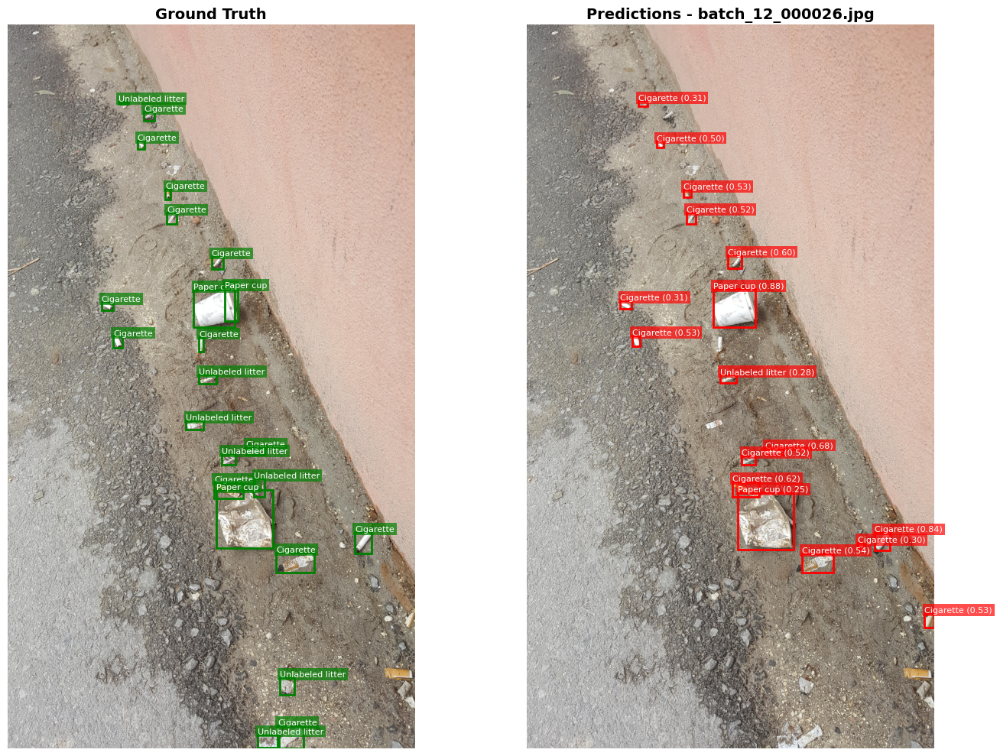

In [11]:
# ============================================================================
# USAR ESTA CELDA PARA VISUALIZAR IMÁGENES
# ============================================================================

# Cambia el path aquí por la imagen que quieras visualizar
IMAGE_TO_VISUALIZE = '/home/rodrigo/Desktop/maestria/trash-detection/data/yolo/test/images/batch_12_000026.jpg'

# Cambia a True si quieres ver también las predicciones del modelo
SHOW_PREDICTIONS = True

visualize_annotations_by_path(IMAGE_TO_VISUALIZE, show_predictions=SHOW_PREDICTIONS)

## 4. Función de Visualización

## 5. Evaluación Completa en Test Set

In [12]:
# Run evaluation on test set
print("Running evaluation on test set...")
print(f"Parameters: conf={CONF_THRESHOLD}, iou={IOU_THRESHOLD}, imgsz={IMG_SIZE}")

# Evaluate all images and store results
all_results = []

for idx, img_path in enumerate(test_images):
    if (idx + 1) % 100 == 0:
        print(f"Processing image {idx + 1}/{len(test_images)}...")
    
    # Load image to get dimensions
    img = Image.open(img_path)
    img_width, img_height = img.size
    
    # Load ground truth
    label_path = test_labels_dir / f"{img_path.stem}.txt"
    gt_boxes = load_yolo_labels(label_path, img_width, img_height)
    
    # Run inference
    results = model.predict(
        source=str(img_path),
        conf=CONF_THRESHOLD,
        iou=IOU_THRESHOLD,
        imgsz=IMG_SIZE,
        max_det=MAX_DET,
        verbose=False
    )
    
    # Extract predictions
    pred_boxes = []
    pred_classes = []
    pred_scores = []
    
    if len(results) > 0 and results[0].boxes is not None:
        boxes = results[0].boxes
        pred_boxes = boxes.xyxy.cpu().numpy().tolist()  # [x1, y1, x2, y2]
        pred_classes = boxes.cls.cpu().numpy().tolist()
        pred_scores = boxes.conf.cpu().numpy().tolist()
    
    # Calculate metrics
    metrics = calculate_image_metrics(
        pred_boxes, 
        pred_classes, 
        gt_boxes,
        iou_threshold=IOU_THRESHOLD
    )
    
    # Store results
    all_results.append({
        'image_path': img_path,
        'image_name': img_path.name,
        'pred_boxes': pred_boxes,
        'pred_classes': pred_classes,
        'pred_scores': pred_scores,
        'gt_boxes': gt_boxes,
        'num_predictions': len(pred_boxes),
        'num_ground_truths': len(gt_boxes),
        'tp': metrics['tp'],
        'fp': metrics['fp'],
        'fn': metrics['fn'],
        'precision': metrics['precision'],
        'recall': metrics['recall'],
        'f1': metrics['f1'],
        'avg_iou': metrics['avg_iou']
    })

print(f"\nEvaluation complete! Processed {len(all_results)} images")

Running evaluation on test set...
Parameters: conf=0.25, iou=0.45, imgsz=640
Processing image 100/629...
Processing image 200/629...
Processing image 300/629...
Processing image 400/629...
Processing image 500/629...
Processing image 600/629...

Evaluation complete! Processed 629 images


## 6. Métricas Generales

In [13]:
# Calculate overall metrics
total_tp = sum(r['tp'] for r in all_results)
total_fp = sum(r['fp'] for r in all_results)
total_fn = sum(r['fn'] for r in all_results)

overall_precision = total_tp / (total_tp + total_fp) if (total_tp + total_fp) > 0 else 0
overall_recall = total_tp / (total_tp + total_fn) if (total_tp + total_fn) > 0 else 0
overall_f1 = 2 * overall_precision * overall_recall / (overall_precision + overall_recall) if (overall_precision + overall_recall) > 0 else 0

avg_iou = np.mean([r['avg_iou'] for r in all_results if r['avg_iou'] > 0])

print("="*60)
print("OVERALL TEST SET METRICS")
print("="*60)
print(f"Total images: {len(all_results)}")
print(f"\nDetections:")
print(f"  True Positives: {total_tp}")
print(f"  False Positives: {total_fp}")
print(f"  False Negatives: {total_fn}")
print(f"\nMetrics:")
print(f"  Precision: {overall_precision:.4f}")
print(f"  Recall: {overall_recall:.4f}")
print(f"  F1-Score: {overall_f1:.4f}")
print(f"  Average IoU: {avg_iou:.4f}")
print("="*60)

OVERALL TEST SET METRICS
Total images: 629

Detections:
  True Positives: 1130
  False Positives: 342
  False Negatives: 832

Metrics:
  Precision: 0.7677
  Recall: 0.5759
  F1-Score: 0.6581
  Average IoU: 0.8305


## 7. Análisis de los Peores Casos

Identificamos y visualizamos las imágenes con peor rendimiento basado en diferentes métricas.

In [14]:
# Create DataFrame for easier analysis
df_results = pd.DataFrame([{
    'image_name': r['image_name'],
    'num_predictions': r['num_predictions'],
    'num_ground_truths': r['num_ground_truths'],
    'tp': r['tp'],
    'fp': r['fp'],
    'fn': r['fn'],
    'precision': r['precision'],
    'recall': r['recall'],
    'f1': r['f1'],
    'avg_iou': r['avg_iou']
} for r in all_results])

# Display statistics
print("Dataset Statistics:")
print(df_results.describe())

# Save results to CSV
results_csv_path = MODEL_DIR / 'test_detailed_results.csv'
df_results.to_csv(results_csv_path, index=False)
print(f"\nResults saved to: {results_csv_path}")

Dataset Statistics:
       num_predictions  num_ground_truths          tp         fp          fn  \
count       629.000000         629.000000  629.000000  629.00000  629.000000   
mean          2.340223           3.119237    1.796502    0.54372    1.322734   
std           2.730808           4.436756    2.387585    0.95608    3.253975   
min           0.000000           1.000000    0.000000    0.00000    0.000000   
25%           1.000000           1.000000    1.000000    0.00000    0.000000   
50%           2.000000           2.000000    1.000000    0.00000    0.000000   
75%           3.000000           3.000000    2.000000    1.00000    1.000000   
max          39.000000          54.000000   30.000000    9.00000   35.000000   

        precision      recall          f1     avg_iou  
count  629.000000  629.000000  629.000000  629.000000  
mean     0.717038    0.680457    0.678089    0.669390  
std      0.397305    0.403971    0.388578    0.339775  
min      0.000000    0.000000    0.

In [15]:
# Identify worst cases by different criteria

# 1. Lowest F1 score (only images with ground truth)
df_with_gt = df_results[df_results['num_ground_truths'] > 0]
worst_f1 = df_with_gt.nsmallest(NUM_WORST_CASES, 'f1')

print(f"\n{NUM_WORST_CASES} WORST CASES BY F1-SCORE:")
print(worst_f1[['image_name', 'f1', 'precision', 'recall', 'num_predictions', 'num_ground_truths']].to_string(index=False))

# 2. Highest false positives
worst_fp = df_results.nlargest(NUM_WORST_CASES, 'fp')

print(f"\n{NUM_WORST_CASES} WORST CASES BY FALSE POSITIVES:")
print(worst_fp[['image_name', 'fp', 'tp', 'fn', 'precision']].to_string(index=False))

# 3. Highest false negatives
worst_fn = df_results.nlargest(NUM_WORST_CASES, 'fn')

print(f"\n{NUM_WORST_CASES} WORST CASES BY FALSE NEGATIVES:")
print(worst_fn[['image_name', 'fn', 'tp', 'fp', 'recall']].to_string(index=False))


20 WORST CASES BY F1-SCORE:
         image_name  f1  precision  recall  num_predictions  num_ground_truths
batch_10_000000.jpg 0.0        0.0     0.0                1                  1
batch_10_000001.jpg 0.0        0.0     0.0                5                 12
batch_10_000006.jpg 0.0        0.0     0.0                2                  4
batch_10_000015.jpg 0.0        0.0     0.0                0                  5
batch_10_000016.jpg 0.0        0.0     0.0                0                  1
batch_10_000018.jpg 0.0        0.0     0.0                4                  1
batch_10_000021.jpg 0.0        0.0     0.0                0                  7
batch_10_000029.jpg 0.0        0.0     0.0                1                  1
batch_10_000038.jpg 0.0        0.0     0.0                2                  2
batch_10_000039.jpg 0.0        0.0     0.0                1                  1
batch_10_000044.jpg 0.0        0.0     0.0                1                  1
batch_10_000046.jpg 0.0

### 7.1 Visualización de Peores Casos por F1-Score

Visualizing 5 worst F1 cases...

Image: batch_10_000000.jpg
  F1: 0.000, Precision: 0.000, Recall: 0.000
  Predictions: 1, Ground Truth: 1
  TP: 0, FP: 1, FN: 1


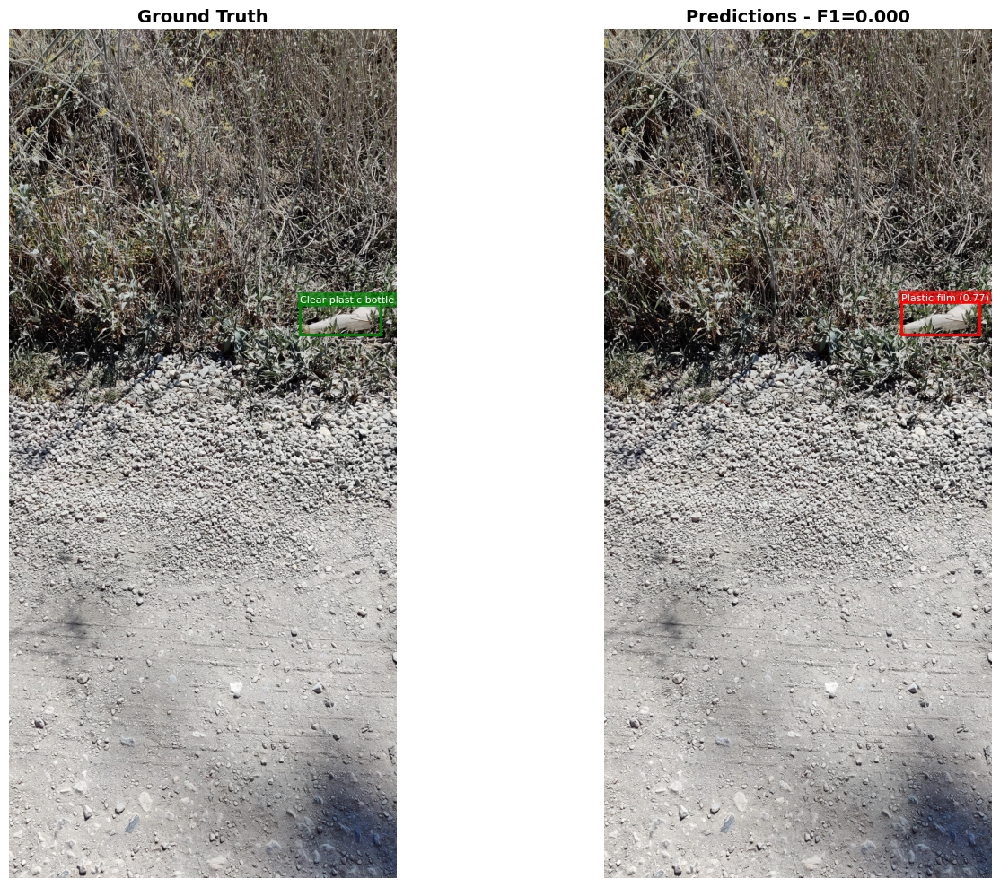



Image: batch_10_000001.jpg
  F1: 0.000, Precision: 0.000, Recall: 0.000
  Predictions: 5, Ground Truth: 12
  TP: 0, FP: 5, FN: 12


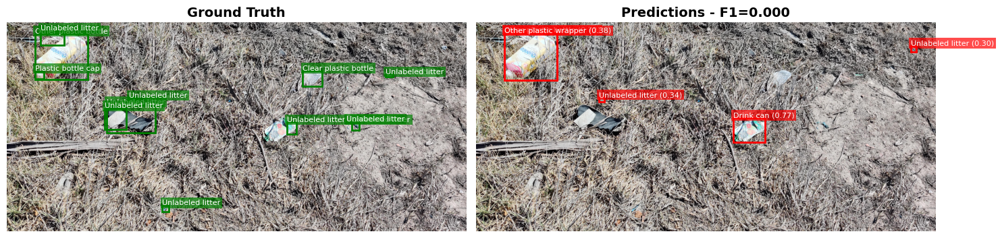



Image: batch_10_000006.jpg
  F1: 0.000, Precision: 0.000, Recall: 0.000
  Predictions: 2, Ground Truth: 4
  TP: 0, FP: 2, FN: 4


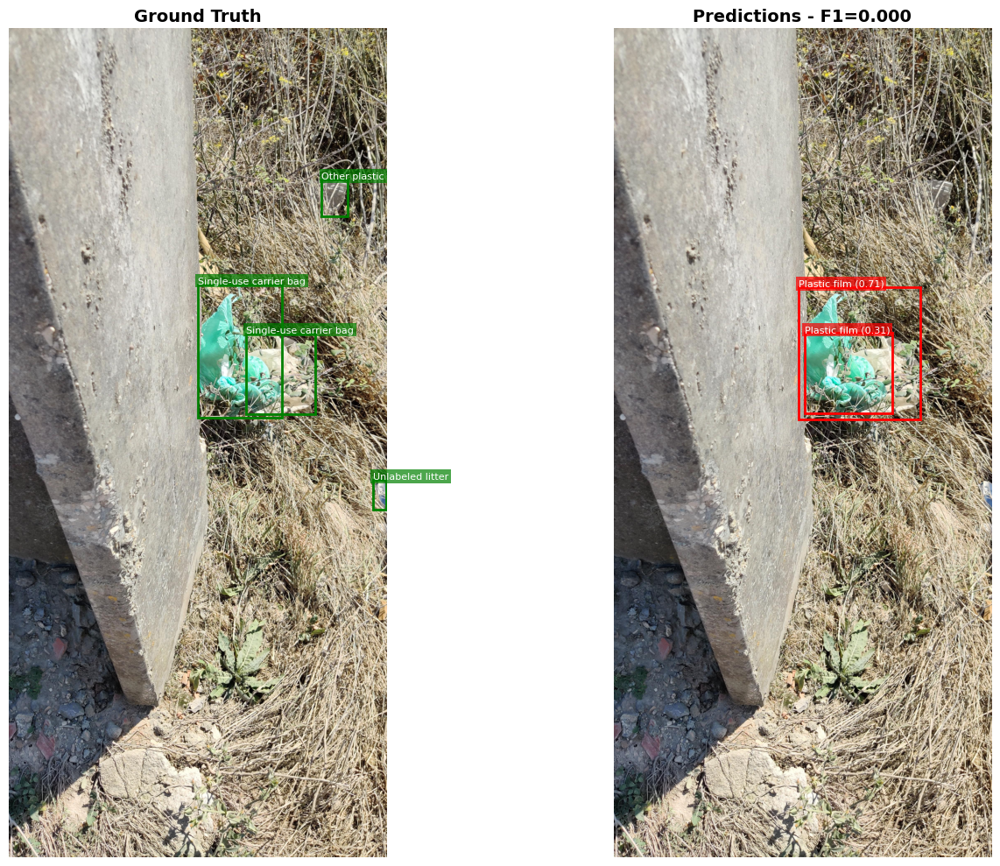



Image: batch_10_000015.jpg
  F1: 0.000, Precision: 0.000, Recall: 0.000
  Predictions: 0, Ground Truth: 5
  TP: 0, FP: 0, FN: 5


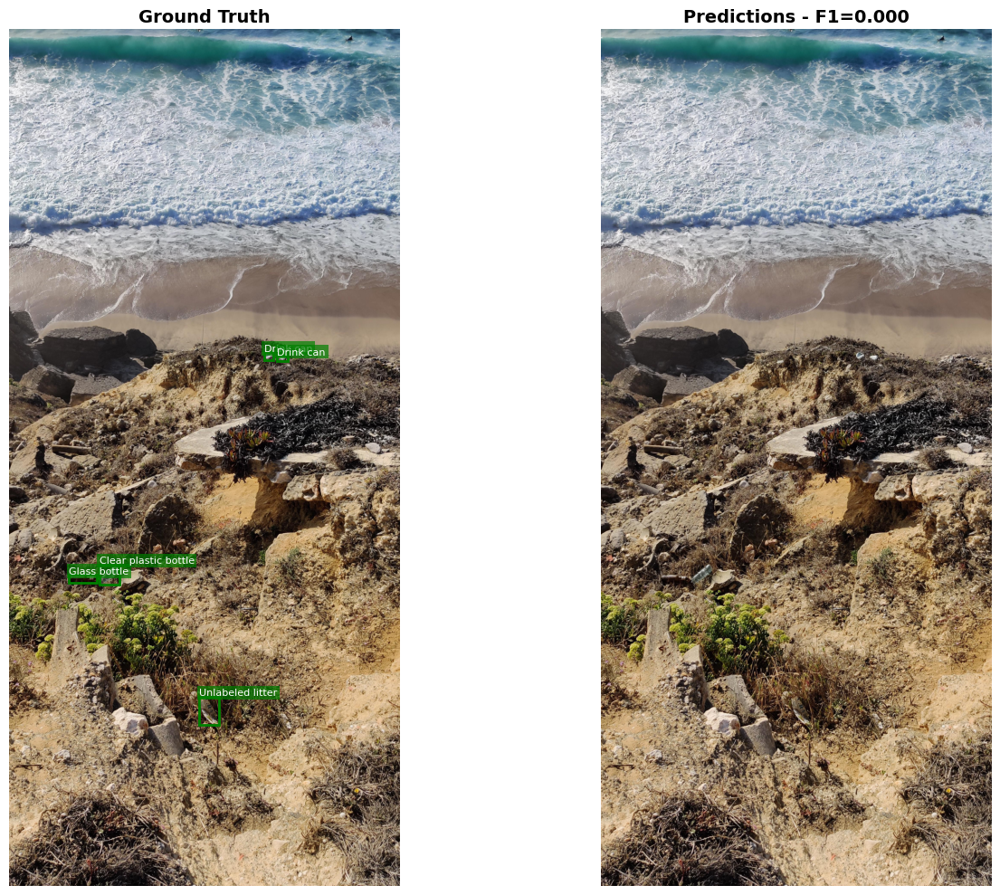



Image: batch_10_000016.jpg
  F1: 0.000, Precision: 0.000, Recall: 0.000
  Predictions: 0, Ground Truth: 1
  TP: 0, FP: 0, FN: 1


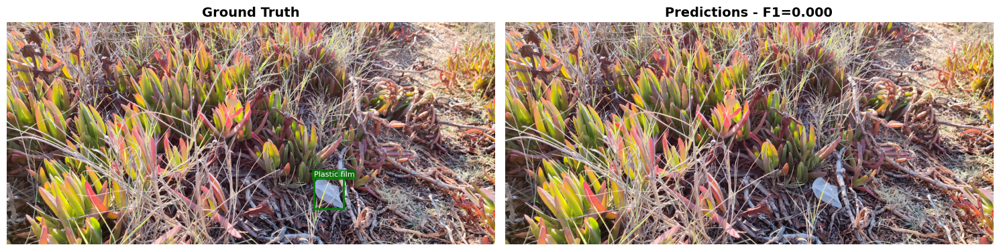

In [16]:
# Visualize worst F1 cases
print(f"Visualizing {min(5, len(worst_f1))} worst F1 cases...\n")

for idx, row in worst_f1.head(5).iterrows():
    # Find the full result
    result = next(r for r in all_results if r['image_name'] == row['image_name'])
    
    print(f"Image: {row['image_name']}")
    print(f"  F1: {row['f1']:.3f}, Precision: {row['precision']:.3f}, Recall: {row['recall']:.3f}")
    print(f"  Predictions: {row['num_predictions']}, Ground Truth: {row['num_ground_truths']}")
    print(f"  TP: {row['tp']}, FP: {row['fp']}, FN: {row['fn']}")
    
    fig = visualize_predictions(
        image_path=result['image_path'],
        pred_boxes=result['pred_boxes'],
        pred_classes=result['pred_classes'],
        pred_scores=result['pred_scores'],
        gt_boxes=result['gt_boxes'],
        class_names=CLASS_NAMES,
        title=f"F1={row['f1']:.3f}"
    )
    plt.show()
    print("\n" + "="*60 + "\n")

### 7.2 Visualización de Peores Casos por False Positives

Visualizing 5 worst False Positive cases...

Image: batch_8_000021.jpg
  False Positives: 9, True Positives: 30
  Precision: 0.769


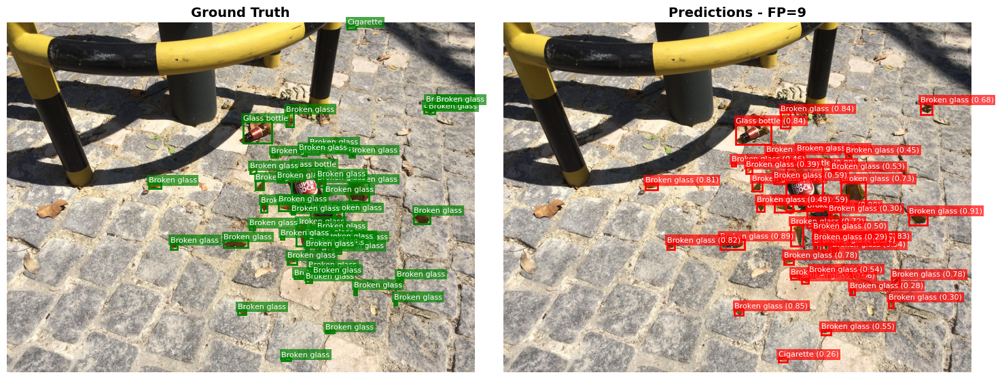



Image: batch_12_000037.jpg
  False Positives: 7, True Positives: 0
  Precision: 0.000


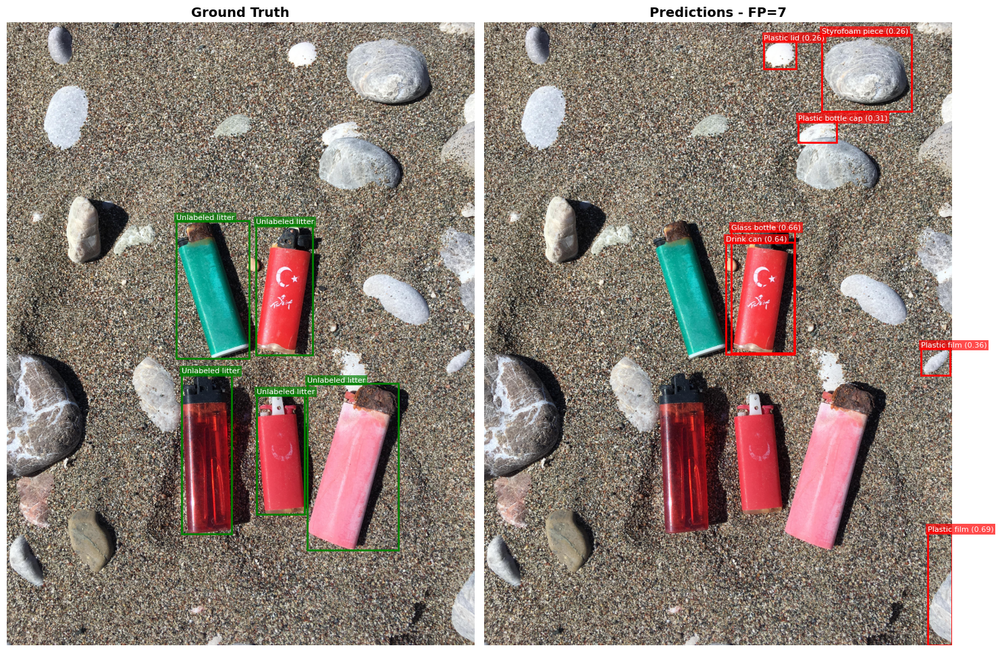



Image: batch_10_000001.jpg
  False Positives: 5, True Positives: 0
  Precision: 0.000


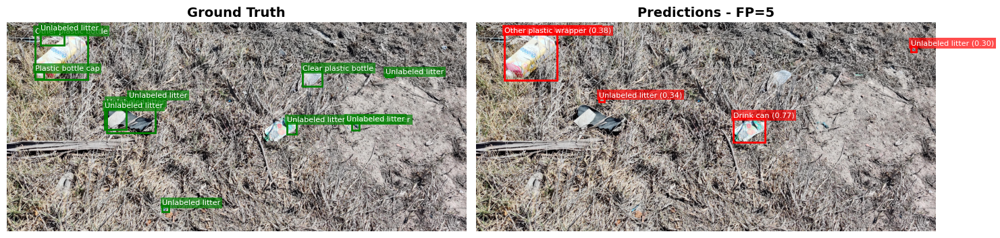



Image: batch_10_000018.jpg
  False Positives: 4, True Positives: 0
  Precision: 0.000


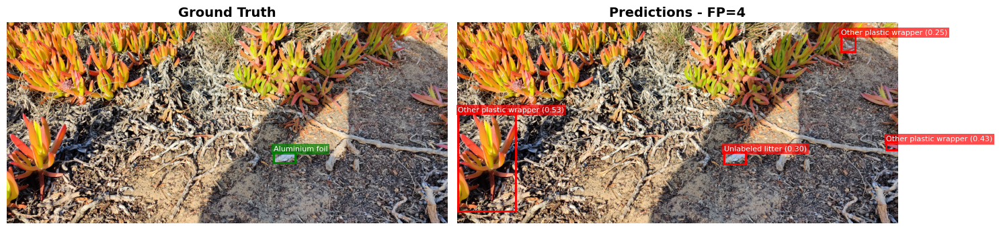



Image: batch_10_000094.jpg
  False Positives: 4, True Positives: 0
  Precision: 0.000


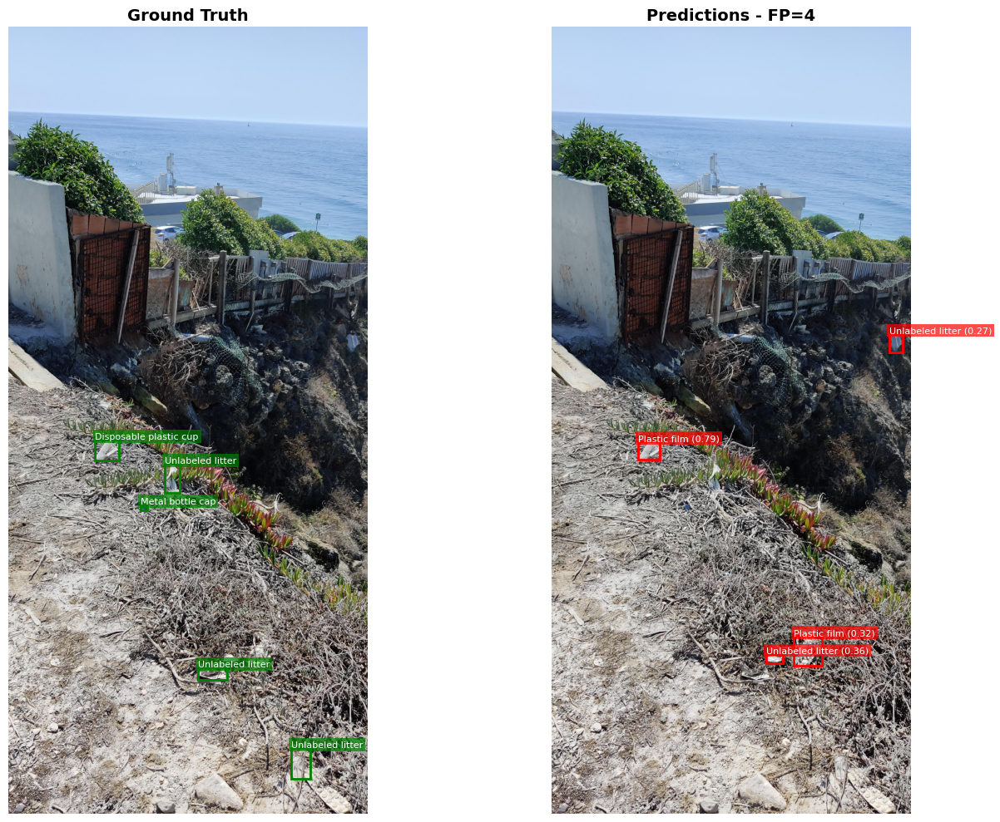

In [17]:
# Visualize worst FP cases
print(f"Visualizing {min(5, len(worst_fp))} worst False Positive cases...\n")

for idx, row in worst_fp.head(5).iterrows():
    result = next(r for r in all_results if r['image_name'] == row['image_name'])
    
    print(f"Image: {row['image_name']}")
    print(f"  False Positives: {row['fp']}, True Positives: {row['tp']}")
    print(f"  Precision: {row['precision']:.3f}")
    
    fig = visualize_predictions(
        image_path=result['image_path'],
        pred_boxes=result['pred_boxes'],
        pred_classes=result['pred_classes'],
        pred_scores=result['pred_scores'],
        gt_boxes=result['gt_boxes'],
        class_names=CLASS_NAMES,
        title=f"FP={row['fp']}"
    )
    plt.show()
    print("\n" + "="*60 + "\n")

### 7.3 Visualización de Peores Casos por False Negatives

Visualizing 5 worst False Negative cases...

Image: batch_13_000025.jpg
  False Negatives: 35, True Positives: 1
  Recall: 0.028


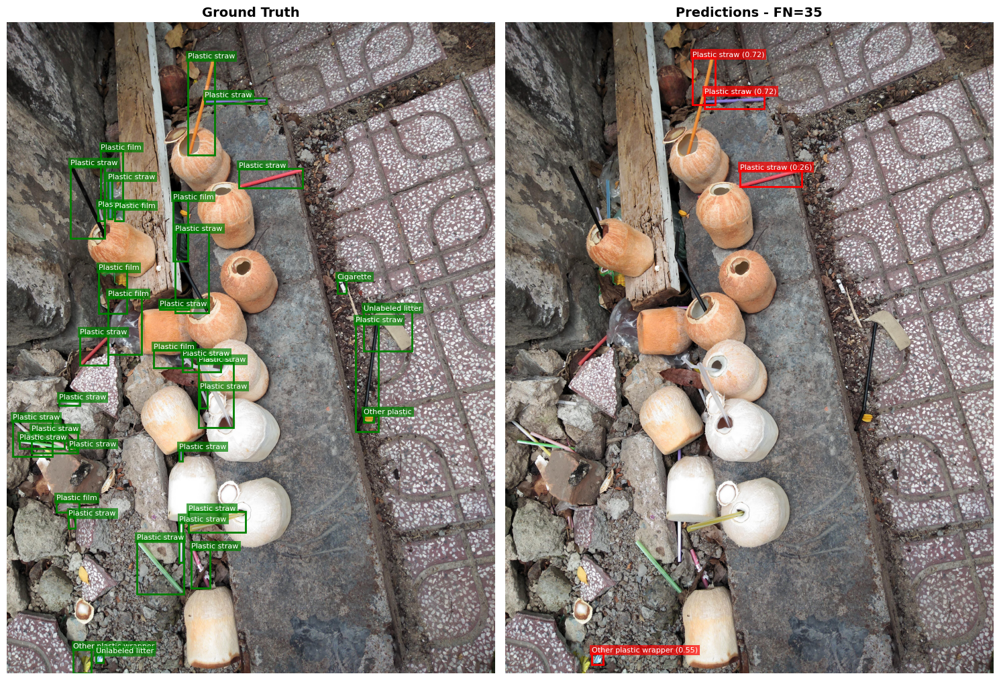



Image: batch_12_000062.jpg
  False Negatives: 34, True Positives: 2
  Recall: 0.056


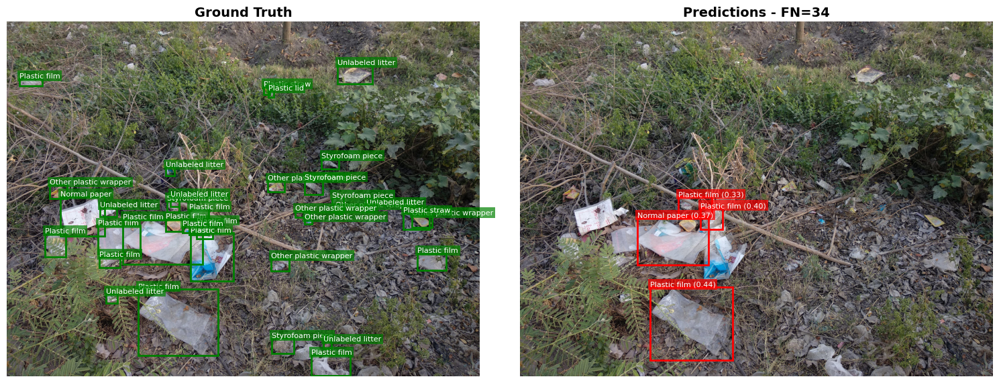



Image: batch_8_000065.jpg
  False Negatives: 27, True Positives: 1
  Recall: 0.036


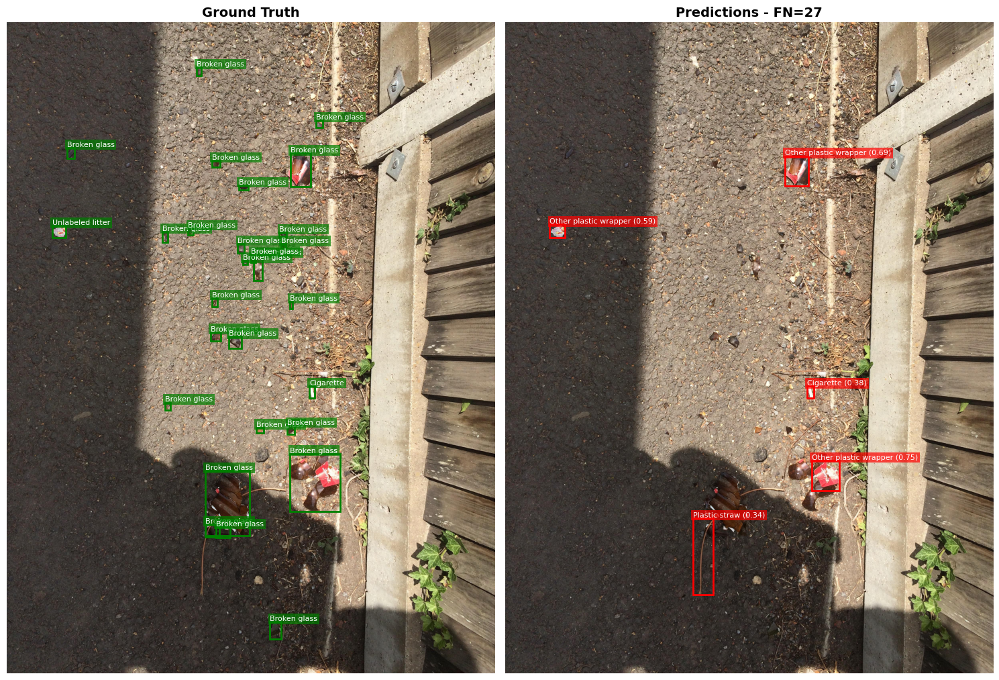



Image: batch_8_000021.jpg
  False Negatives: 24, True Positives: 30
  Recall: 0.556


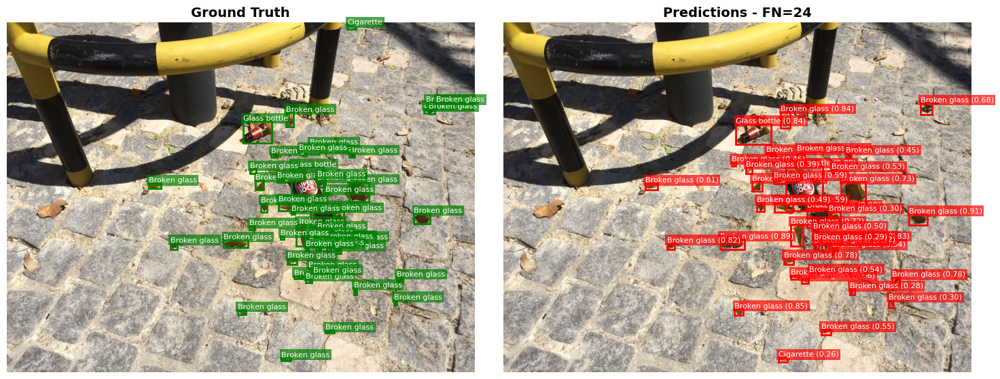



Image: batch_12_000024.jpg
  False Negatives: 21, True Positives: 4
  Recall: 0.160


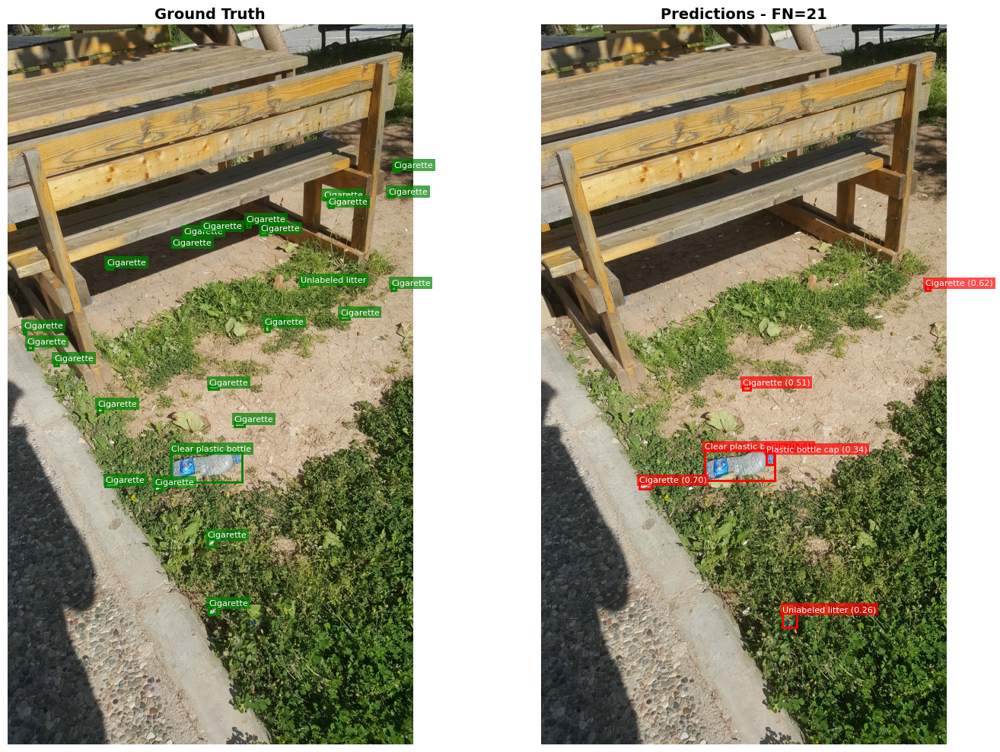

In [18]:
# Visualize worst FN cases
print(f"Visualizing {min(5, len(worst_fn))} worst False Negative cases...\n")

for idx, row in worst_fn.head(5).iterrows():
    result = next(r for r in all_results if r['image_name'] == row['image_name'])
    
    print(f"Image: {row['image_name']}")
    print(f"  False Negatives: {row['fn']}, True Positives: {row['tp']}")
    print(f"  Recall: {row['recall']:.3f}")
    
    fig = visualize_predictions(
        image_path=result['image_path'],
        pred_boxes=result['pred_boxes'],
        pred_classes=result['pred_classes'],
        pred_scores=result['pred_scores'],
        gt_boxes=result['gt_boxes'],
        class_names=CLASS_NAMES,
        title=f"FN={row['fn']}"
    )
    plt.show()
    print("\n" + "="*60 + "\n")

## 8. Selector de Casos Aleatorios

Visualiza casos aleatorios del dataset para un análisis general.

Visualizing 10 random samples...

Image: batch_13_000027.jpg
  F1: 0.000, Precision: 0.000, Recall: 0.000
  Predictions: 1, Ground Truth: 2


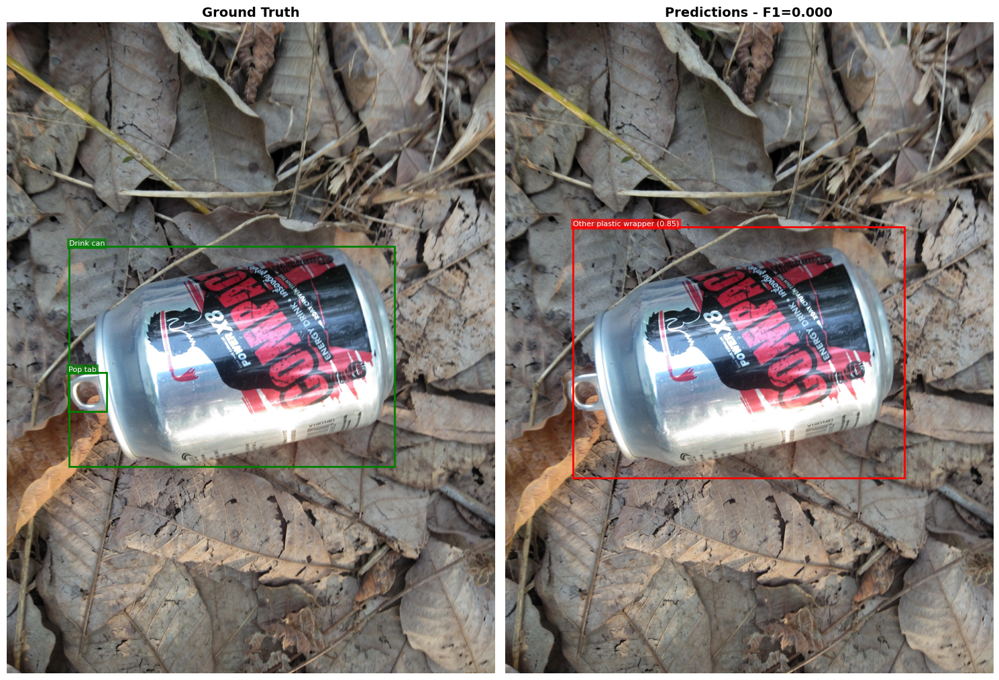



Image: batch_12_000070.jpg
  F1: 0.000, Precision: 0.000, Recall: 0.000
  Predictions: 0, Ground Truth: 1


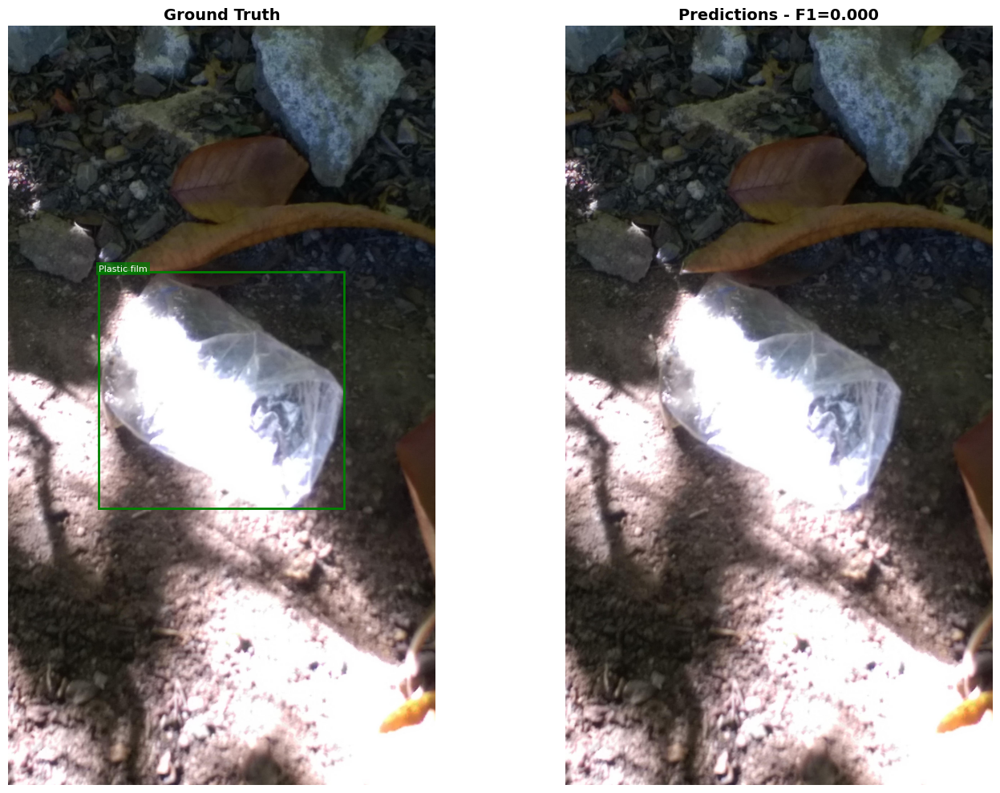



Image: batch_9_000012.jpg
  F1: 1.000, Precision: 1.000, Recall: 1.000
  Predictions: 1, Ground Truth: 1


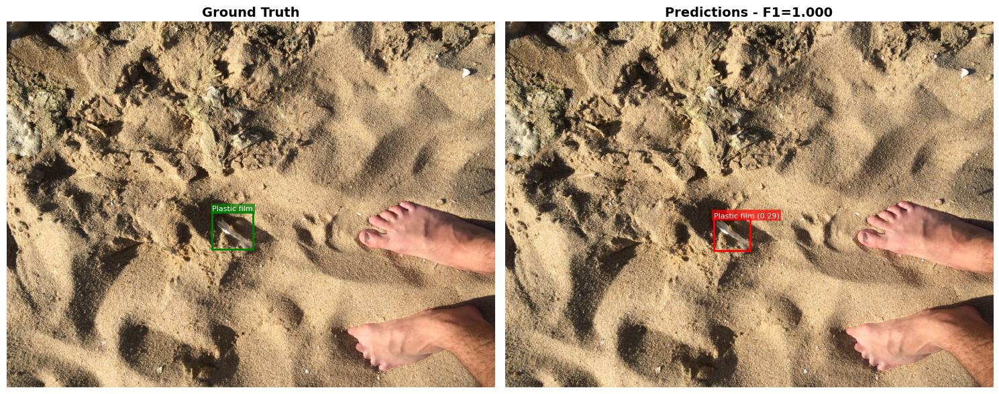



Image: batch_13_000073.jpg
  F1: 0.000, Precision: 0.000, Recall: 0.000
  Predictions: 1, Ground Truth: 1


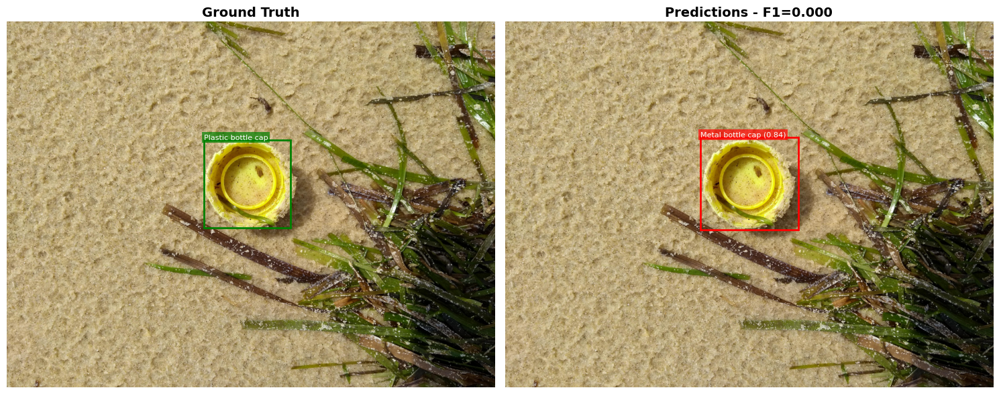



Image: batch_9_000090.jpg
  F1: 0.750, Precision: 1.000, Recall: 0.600
  Predictions: 3, Ground Truth: 5


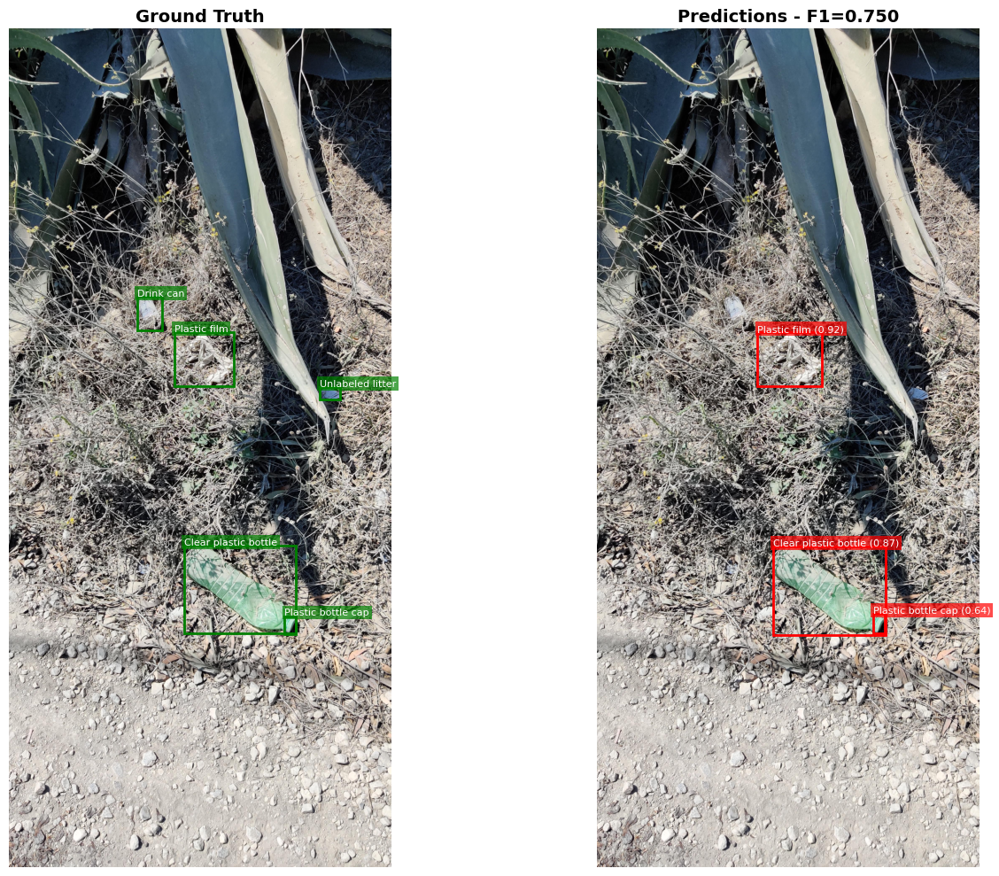



Image: batch_10_000053.jpg
  F1: 1.000, Precision: 1.000, Recall: 1.000
  Predictions: 1, Ground Truth: 1


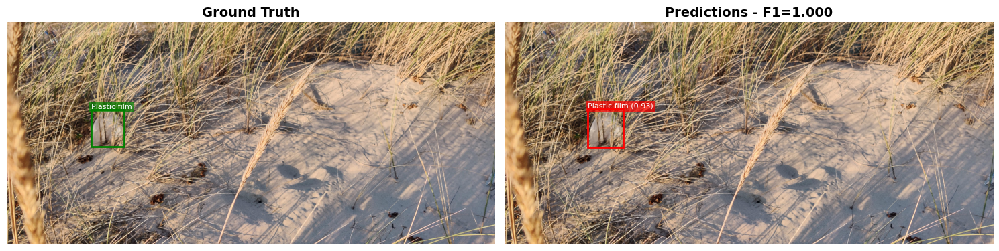



Image: batch_15_000035.jpg
  F1: 0.000, Precision: 0.000, Recall: 0.000
  Predictions: 2, Ground Truth: 2


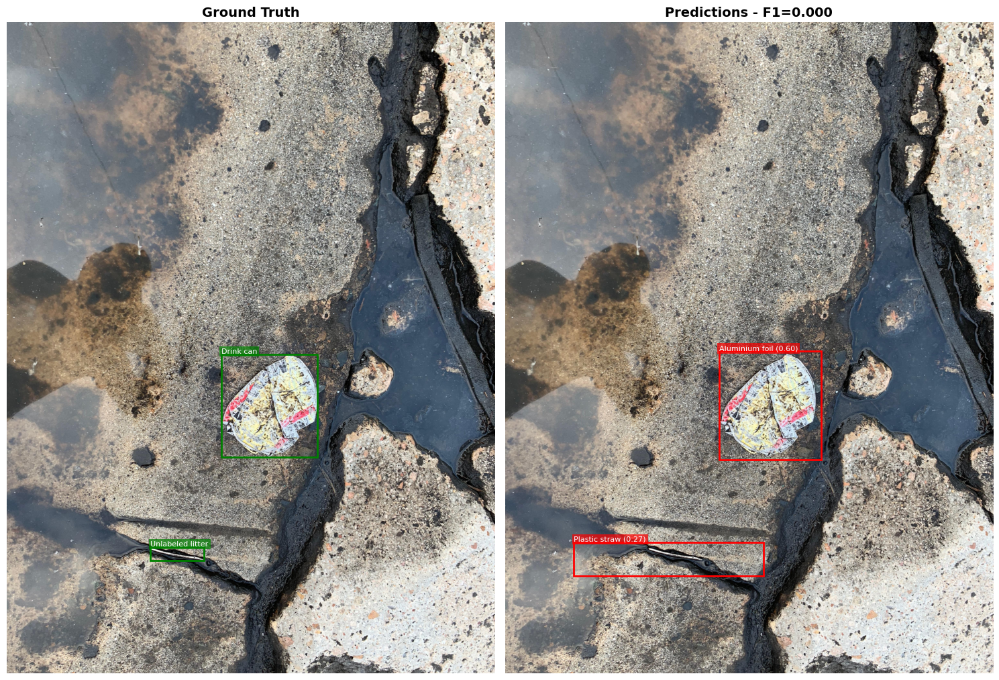



Image: batch_9_000028.jpg
  F1: 0.533, Precision: 0.667, Recall: 0.444
  Predictions: 6, Ground Truth: 9


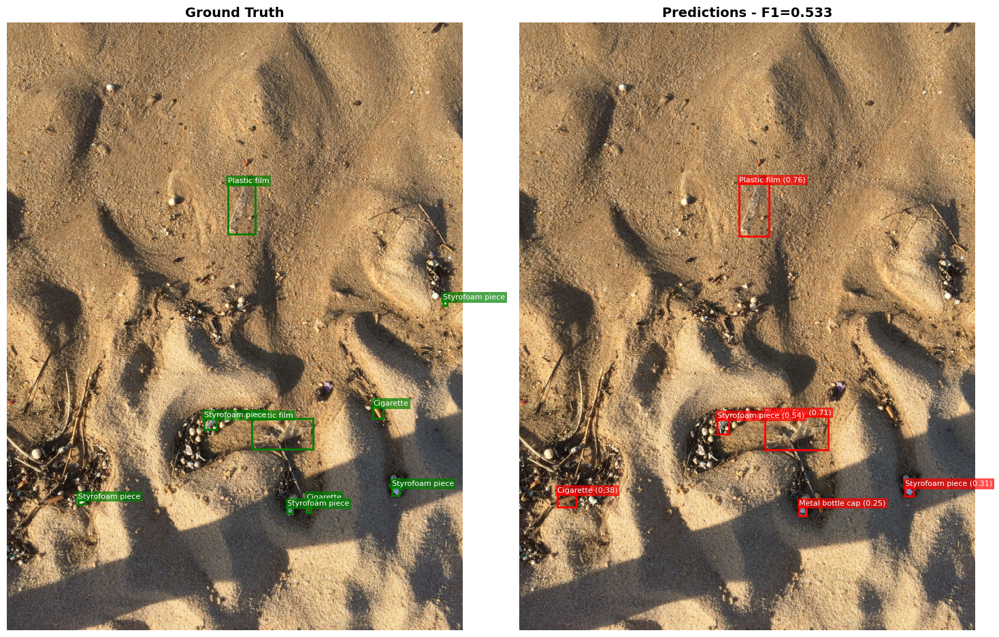



Image: batch_9_000039.jpg
  F1: 0.667, Precision: 1.000, Recall: 0.500
  Predictions: 2, Ground Truth: 4


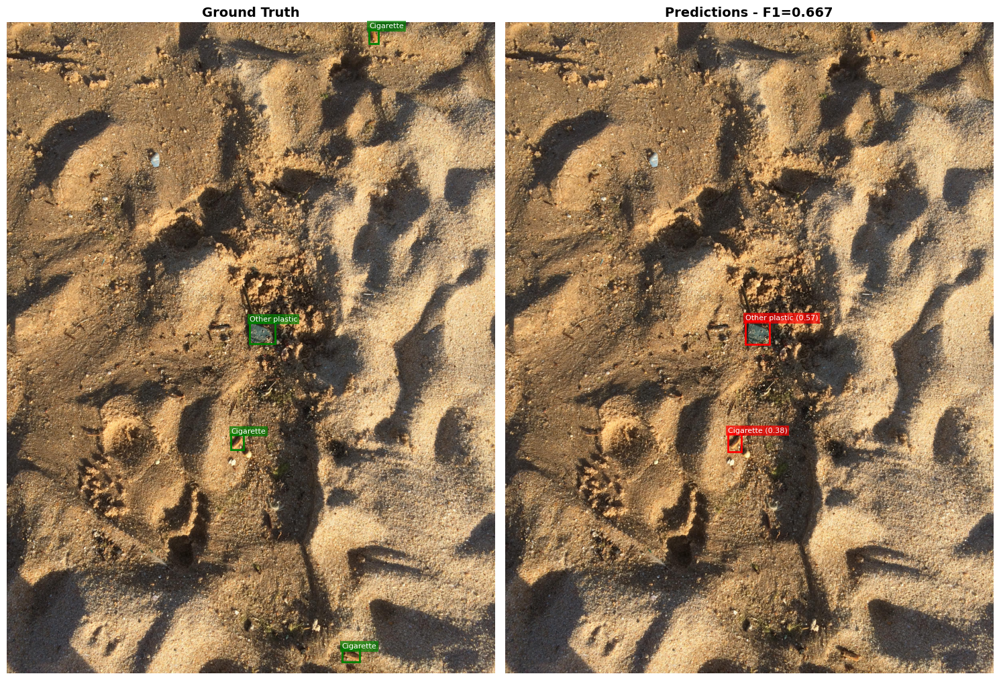



Image: batch_12_000048.jpg
  F1: 1.000, Precision: 1.000, Recall: 1.000
  Predictions: 1, Ground Truth: 1


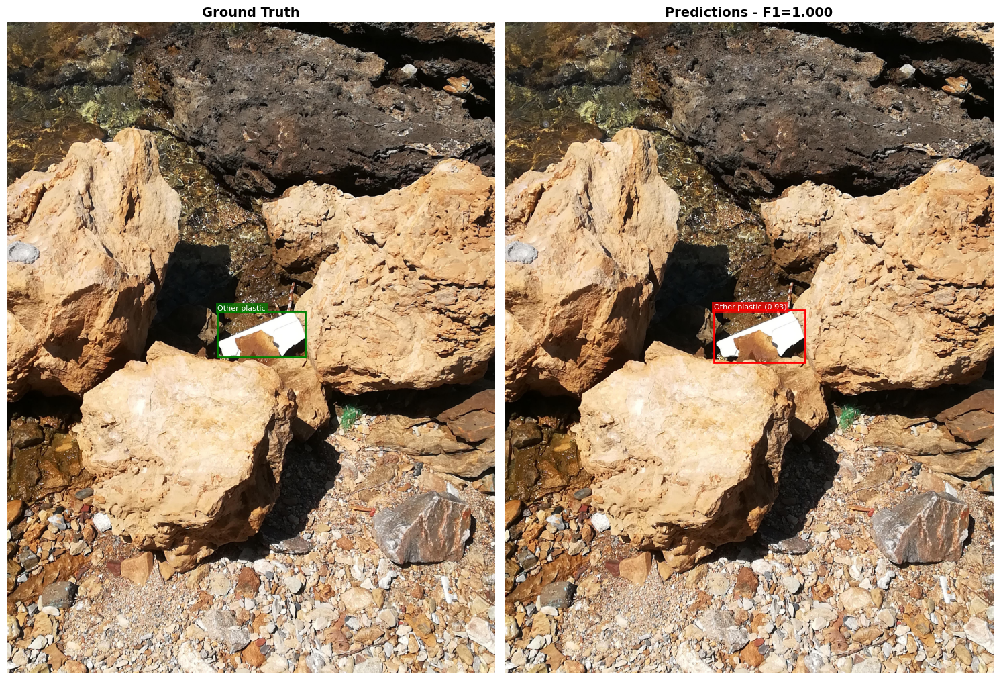

In [19]:
# Select random samples
random_samples = random.sample(all_results, min(NUM_RANDOM_SAMPLES, len(all_results)))

print(f"Visualizing {len(random_samples)} random samples...\n")

for result in random_samples:
    # Get metrics for this image
    row = df_results[df_results['image_name'] == result['image_name']].iloc[0]
    
    print(f"Image: {result['image_name']}")
    print(f"  F1: {row['f1']:.3f}, Precision: {row['precision']:.3f}, Recall: {row['recall']:.3f}")
    print(f"  Predictions: {row['num_predictions']}, Ground Truth: {row['num_ground_truths']}")
    
    fig = visualize_predictions(
        image_path=result['image_path'],
        pred_boxes=result['pred_boxes'],
        pred_classes=result['pred_classes'],
        pred_scores=result['pred_scores'],
        gt_boxes=result['gt_boxes'],
        class_names=CLASS_NAMES,
        title=f"F1={row['f1']:.3f}"
    )
    plt.show()
    print("\n" + "="*60 + "\n")

## 9. Experimentar con Diferentes Thresholds

Esta sección permite re-evaluar casos específicos con diferentes configuraciones de confidence y IoU.

In [20]:
# ============================================================================
# CONFIGURACIÓN DE EXPERIMENTO - Modificar para probar diferentes thresholds
# ============================================================================

# Select an image to experiment with (by name or index)
EXPERIMENT_IMAGE_IDX = 0  # Change this to test different images
# Or use a specific image name:
# EXPERIMENT_IMAGE_NAME = 'batch_1_000033.jpg'

# Thresholds to experiment with
EXPERIMENT_CONF_THRESHOLDS = [0.1, 0.25, 0.5, 0.7, 0.9]
EXPERIMENT_IOU = 0.45  # Keep IoU constant for this experiment

print(f"Experimenting with different confidence thresholds...")
print(f"Confidence thresholds: {EXPERIMENT_CONF_THRESHOLDS}")
print(f"IoU threshold: {EXPERIMENT_IOU}")

Experimenting with different confidence thresholds...
Confidence thresholds: [0.1, 0.25, 0.5, 0.7, 0.9]
IoU threshold: 0.45


In [21]:
# Select image for experiment
if 'EXPERIMENT_IMAGE_NAME' in locals():
    experiment_image = next(img for img in test_images if img.name == EXPERIMENT_IMAGE_NAME)
else:
    experiment_image = test_images[EXPERIMENT_IMAGE_IDX]

print(f"\nExperimenting with image: {experiment_image.name}")

# Load ground truth
img = Image.open(experiment_image)
img_width, img_height = img.size
label_path = test_labels_dir / f"{experiment_image.stem}.txt"
gt_boxes = load_yolo_labels(label_path, img_width, img_height)

print(f"Ground truth boxes: {len(gt_boxes)}")

# Test different confidence thresholds
threshold_results = []

for conf_thresh in EXPERIMENT_CONF_THRESHOLDS:
    # Run inference
    results = model.predict(
        source=str(experiment_image),
        conf=conf_thresh,
        iou=EXPERIMENT_IOU,
        imgsz=IMG_SIZE,
        max_det=MAX_DET,
        verbose=False
    )
    
    # Extract predictions
    pred_boxes = []
    pred_classes = []
    pred_scores = []
    
    if len(results) > 0 and results[0].boxes is not None:
        boxes = results[0].boxes
        pred_boxes = boxes.xyxy.cpu().numpy().tolist()
        pred_classes = boxes.cls.cpu().numpy().tolist()
        pred_scores = boxes.conf.cpu().numpy().tolist()
    
    # Calculate metrics
    metrics = calculate_image_metrics(
        pred_boxes, 
        pred_classes, 
        gt_boxes,
        iou_threshold=EXPERIMENT_IOU
    )
    
    threshold_results.append({
        'conf_threshold': conf_thresh,
        'num_detections': len(pred_boxes),
        'pred_boxes': pred_boxes,
        'pred_classes': pred_classes,
        'pred_scores': pred_scores,
        **metrics
    })

# Display results table
df_threshold = pd.DataFrame(threshold_results)
print("\nResults by Confidence Threshold:")
print(df_threshold[['conf_threshold', 'num_detections', 'tp', 'fp', 'fn', 'precision', 'recall', 'f1']].to_string(index=False))


Experimenting with image: batch_10_000000.jpg
Ground truth boxes: 1

Results by Confidence Threshold:
 conf_threshold  num_detections  tp  fp  fn  precision  recall  f1
           0.10               2   0   2   1        0.0     0.0 0.0
           0.25               1   0   1   1        0.0     0.0 0.0
           0.50               1   0   1   1        0.0     0.0 0.0
           0.70               1   0   1   1        0.0     0.0 0.0
           0.90               0   0   0   1        0.0     0.0 0.0



Visualizing predictions with different confidence thresholds...

Confidence Threshold: 0.1
  Detections: 2
  TP: 0, FP: 2, FN: 1
  Precision: 0.000, Recall: 0.000, F1: 0.000


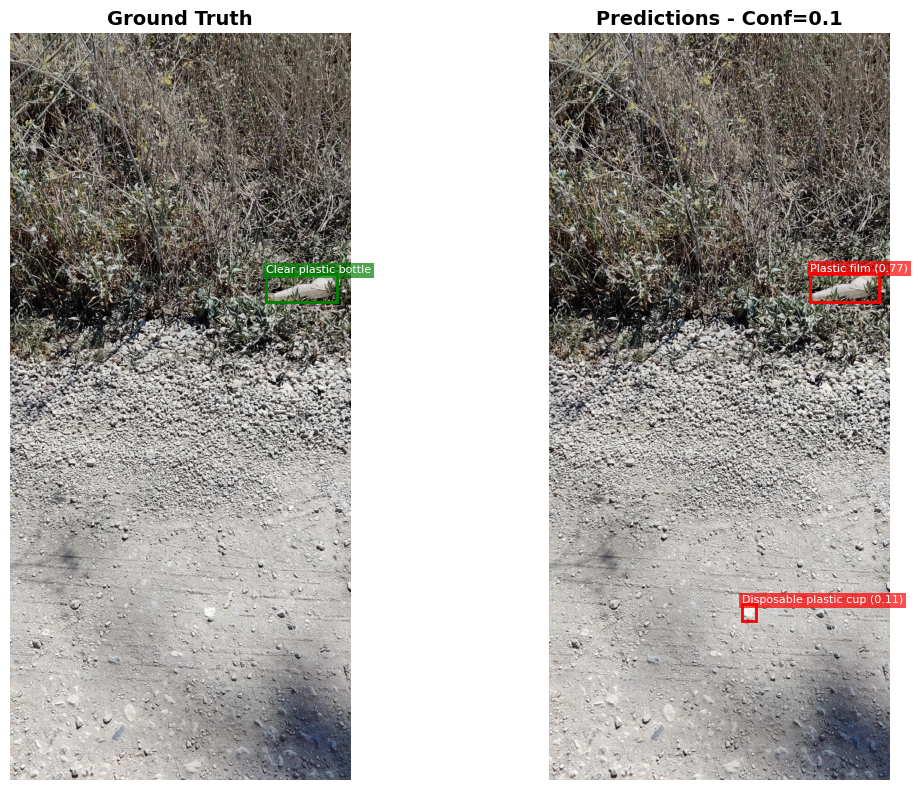



Confidence Threshold: 0.25
  Detections: 1
  TP: 0, FP: 1, FN: 1
  Precision: 0.000, Recall: 0.000, F1: 0.000


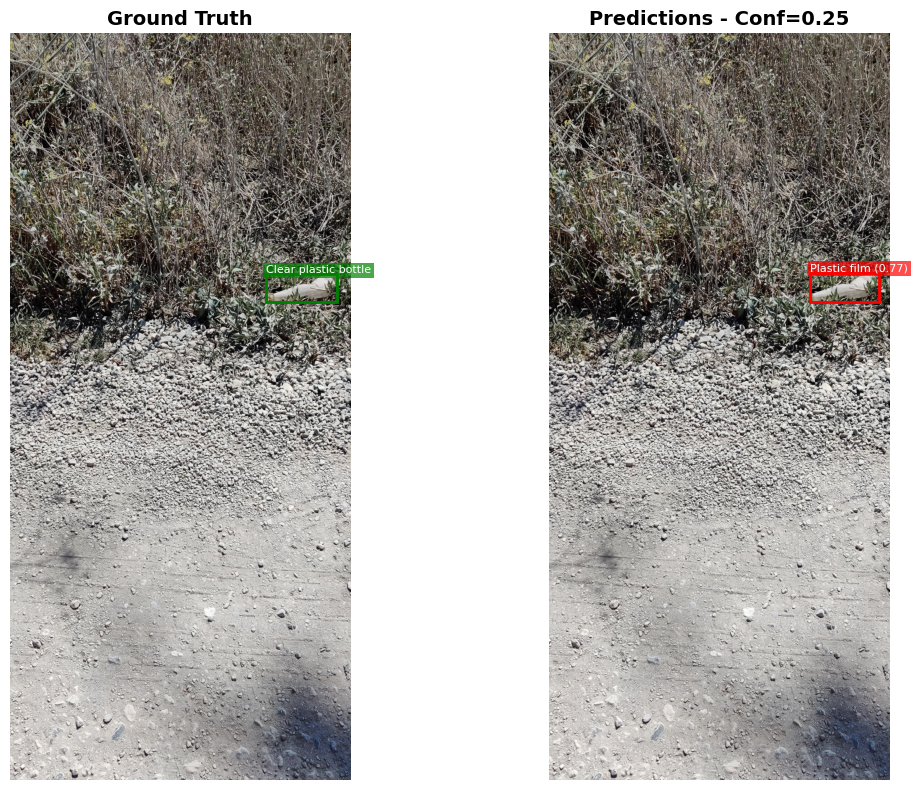



Confidence Threshold: 0.5
  Detections: 1
  TP: 0, FP: 1, FN: 1
  Precision: 0.000, Recall: 0.000, F1: 0.000


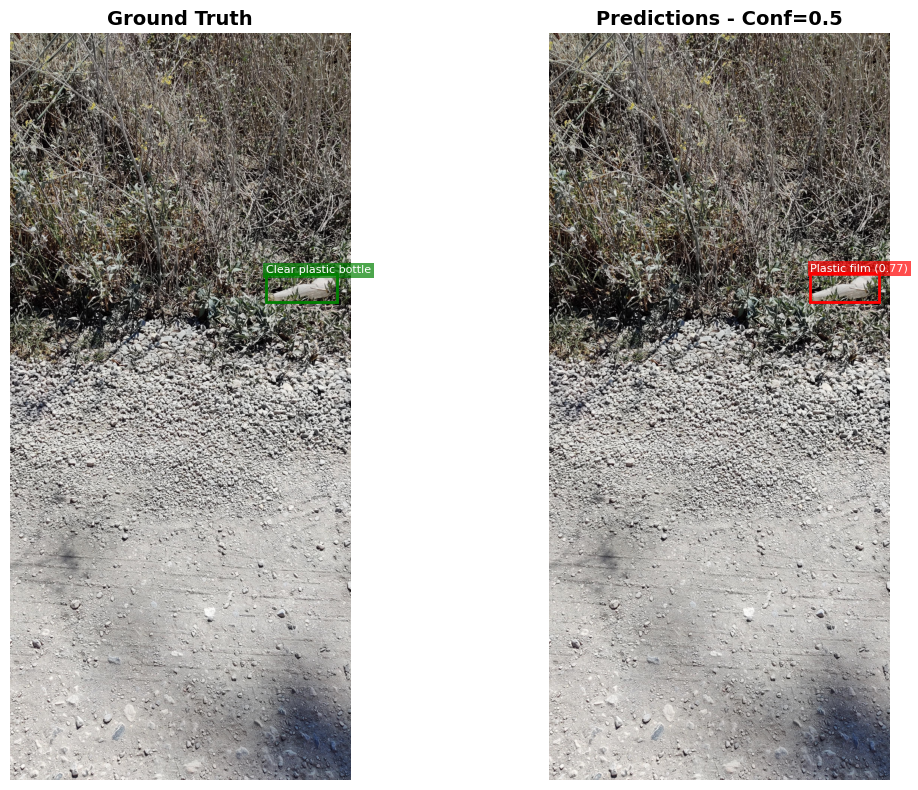



Confidence Threshold: 0.7
  Detections: 1
  TP: 0, FP: 1, FN: 1
  Precision: 0.000, Recall: 0.000, F1: 0.000


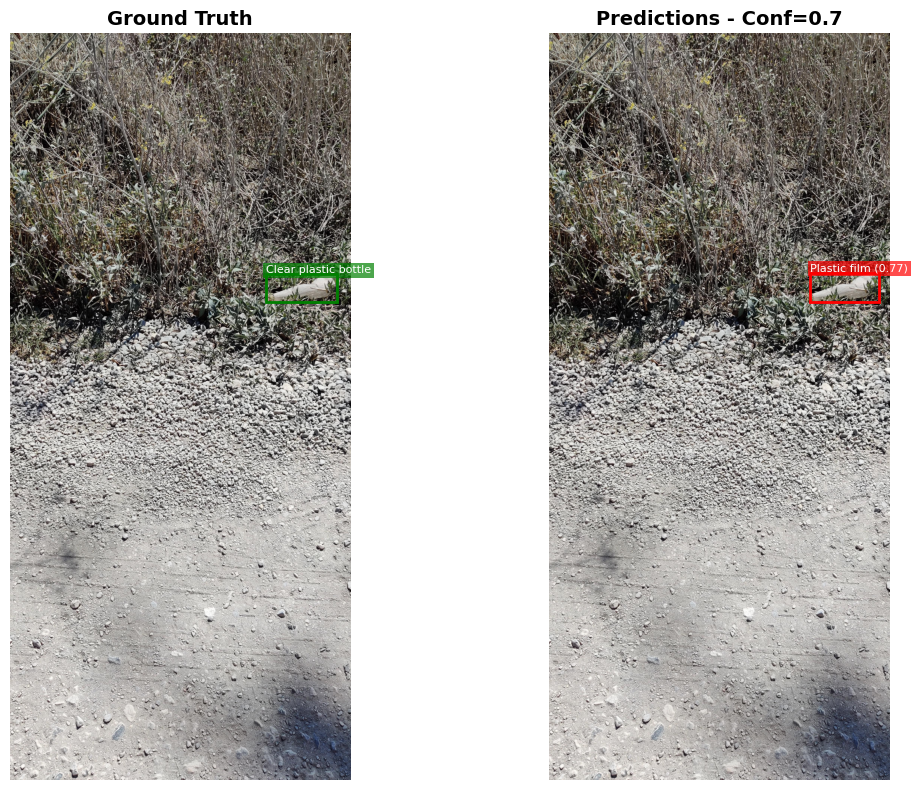



Confidence Threshold: 0.9
  Detections: 0
  TP: 0, FP: 0, FN: 1
  Precision: 0.000, Recall: 0.000, F1: 0.000


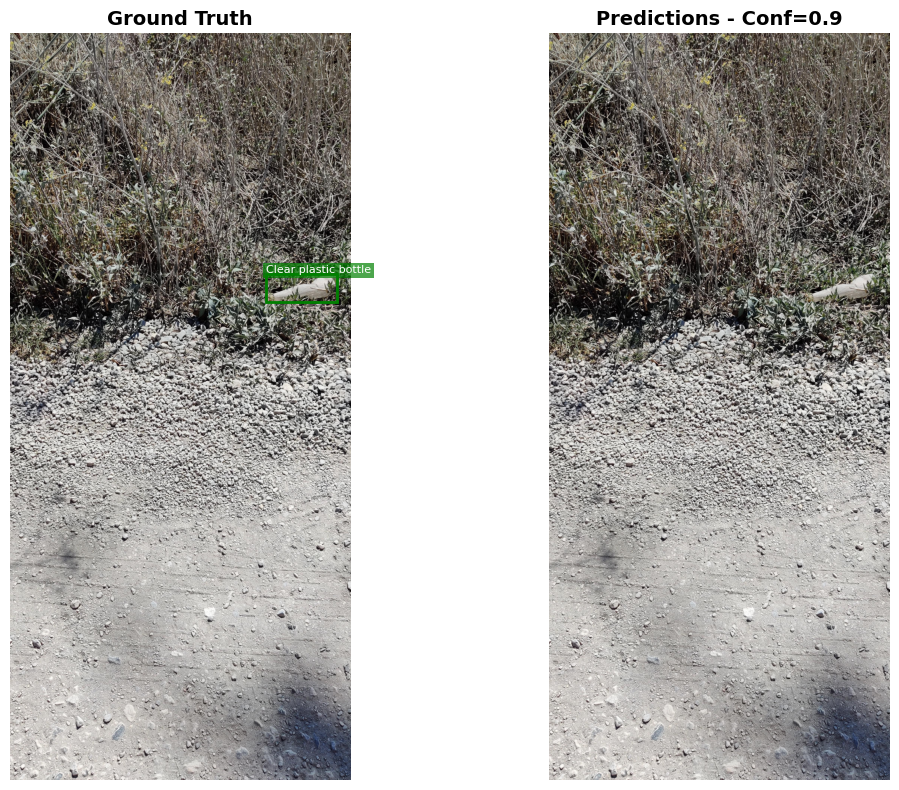

In [22]:
# Visualize results for each threshold
print(f"\nVisualizing predictions with different confidence thresholds...\n")

for result in threshold_results:
    conf_thresh = result['conf_threshold']
    
    print(f"Confidence Threshold: {conf_thresh}")
    print(f"  Detections: {result['num_detections']}")
    print(f"  TP: {result['tp']}, FP: {result['fp']}, FN: {result['fn']}")
    print(f"  Precision: {result['precision']:.3f}, Recall: {result['recall']:.3f}, F1: {result['f1']:.3f}")
    
    fig = visualize_predictions(
        image_path=experiment_image,
        pred_boxes=result['pred_boxes'],
        pred_classes=result['pred_classes'],
        pred_scores=result['pred_scores'],
        gt_boxes=gt_boxes,
        class_names=CLASS_NAMES,
        title=f"Conf={conf_thresh}",
        figsize=(12, 8)
    )
    plt.show()
    print("\n" + "="*60 + "\n")

## 10. Análisis por Clase

Analiza el rendimiento del modelo por cada clase de objeto.

In [23]:
# Calculate per-class statistics
class_stats = defaultdict(lambda: {'tp': 0, 'fp': 0, 'fn': 0, 'count': 0})

for result in all_results:
    pred_boxes = result['pred_boxes']
    pred_classes = result['pred_classes']
    gt_boxes = result['gt_boxes']
    
    # Count ground truth instances per class
    for gt_box in gt_boxes:
        class_id = int(gt_box[0])
        class_stats[class_id]['count'] += 1
    
    # Match predictions to ground truth for per-class metrics
    gt_matched = [False] * len(gt_boxes)
    
    for pred_box, pred_class in zip(pred_boxes, pred_classes):
        pred_class = int(pred_class)
        best_iou = 0
        best_idx = -1
        
        for idx, gt_box in enumerate(gt_boxes):
            if gt_matched[idx]:
                continue
            
            gt_class = int(gt_box[0])
            if pred_class != gt_class:
                continue
            
            iou = calculate_iou(pred_box, gt_box[1:])
            if iou > best_iou:
                best_iou = iou
                best_idx = idx
        
        if best_iou >= IOU_THRESHOLD and best_idx >= 0:
            class_stats[pred_class]['tp'] += 1
            gt_matched[best_idx] = True
        else:
            class_stats[pred_class]['fp'] += 1
    
    # Count false negatives
    for idx, gt_box in enumerate(gt_boxes):
        if not gt_matched[idx]:
            class_id = int(gt_box[0])
            class_stats[class_id]['fn'] += 1

# Calculate metrics per class
class_metrics = []
for class_id in range(NUM_CLASSES):
    stats = class_stats[class_id]
    tp = stats['tp']
    fp = stats['fp']
    fn = stats['fn']
    count = stats['count']
    
    precision = tp / (tp + fp) if (tp + fp) > 0 else 0
    recall = tp / (tp + fn) if (tp + fn) > 0 else 0
    f1 = 2 * precision * recall / (precision + recall) if (precision + recall) > 0 else 0
    
    class_metrics.append({
        'class_id': class_id,
        'class_name': CLASS_NAMES[class_id],
        'instances': count,
        'tp': tp,
        'fp': fp,
        'fn': fn,
        'precision': precision,
        'recall': recall,
        'f1': f1
    })

df_class_metrics = pd.DataFrame(class_metrics)

# Filter classes that appear in test set
df_class_metrics_filtered = df_class_metrics[df_class_metrics['instances'] > 0]

print("\nPer-Class Metrics (classes with instances in test set):")
print(df_class_metrics_filtered.to_string(index=False))

# Save to CSV
class_metrics_csv = MODEL_DIR / 'test_class_metrics.csv'
df_class_metrics.to_csv(class_metrics_csv, index=False)
print(f"\nClass metrics saved to: {class_metrics_csv}")


Per-Class Metrics (classes with instances in test set):
 class_id             class_name  instances  tp  fp  fn  precision   recall       f1
        0         Aluminium foil         10   8   7   2   0.533333 0.800000 0.640000
        1   Other plastic bottle         32  25   3   7   0.892857 0.781250 0.833333
        2   Clear plastic bottle        112  95  15  17   0.863636 0.848214 0.855856
        3           Glass bottle         63  45   8  18   0.849057 0.714286 0.775862
        4     Plastic bottle cap         92  61  12  31   0.835616 0.663043 0.739394
        5       Metal bottle cap         40  20   9  20   0.689655 0.500000 0.579710
        6           Broken glass        104  36  10  68   0.782609 0.346154 0.480000
        7              Drink can         92  76  25  16   0.752475 0.826087 0.787565
        8           Other carton         38  28  16  10   0.636364 0.736842 0.682927
        9      Corrugated carton         26  19   5   7   0.791667 0.730769 0.760000
       1

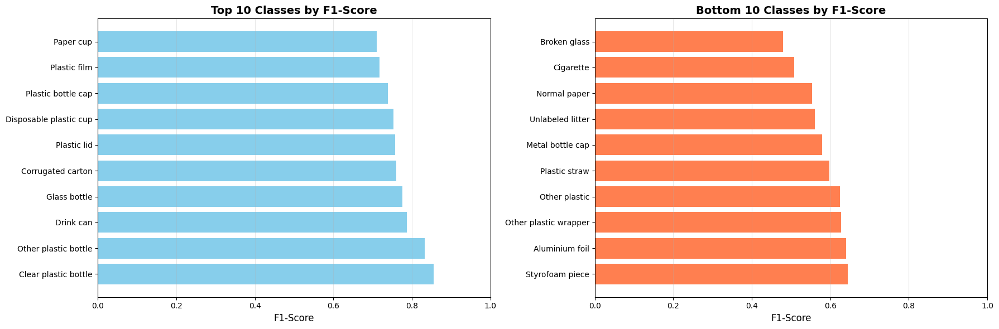

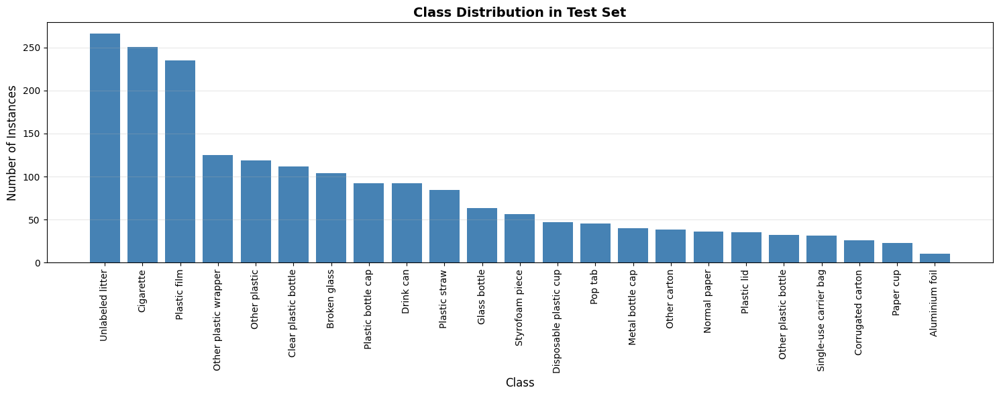

In [24]:
# Plot class performance
df_sorted = df_class_metrics_filtered.sort_values('f1', ascending=False)

# Top 10 classes
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 6))

top_10 = df_sorted.head(10)
ax1.barh(top_10['class_name'], top_10['f1'], color='skyblue')
ax1.set_xlabel('F1-Score', fontsize=12)
ax1.set_title('Top 10 Classes by F1-Score', fontsize=14, fontweight='bold')
ax1.set_xlim(0, 1)
ax1.grid(axis='x', alpha=0.3)

# Bottom 10 classes
bottom_10 = df_sorted.tail(10)
ax2.barh(bottom_10['class_name'], bottom_10['f1'], color='coral')
ax2.set_xlabel('F1-Score', fontsize=12)
ax2.set_title('Bottom 10 Classes by F1-Score', fontsize=14, fontweight='bold')
ax2.set_xlim(0, 1)
ax2.grid(axis='x', alpha=0.3)

plt.tight_layout()
plt.show()

# Plot class distribution
plt.figure(figsize=(15, 6))
df_sorted_instances = df_class_metrics_filtered.sort_values('instances', ascending=False)
plt.bar(range(len(df_sorted_instances)), df_sorted_instances['instances'], color='steelblue')
plt.xticks(range(len(df_sorted_instances)), df_sorted_instances['class_name'], rotation=90)
plt.xlabel('Class', fontsize=12)
plt.ylabel('Number of Instances', fontsize=12)
plt.title('Class Distribution in Test Set', fontsize=14, fontweight='bold')
plt.grid(axis='y', alpha=0.3)
plt.tight_layout()
plt.show()

## 11. Resumen Final

In [25]:
print("="*80)
print("RESUMEN DE EVALUACIÓN YOLOV11")
print("="*80)
print(f"\nModelo: {MODEL_RUN}")
print(f"Pesos: {BEST_WEIGHTS.name}")

print(f"\nParámetros de evaluación:")
print(f"  Confidence threshold: {CONF_THRESHOLD}")
print(f"  IoU threshold: {IOU_THRESHOLD}")
print(f"  Image size: {IMG_SIZE}")

print(f"\nDataset de test:")
print(f"  Total de imágenes: {len(all_results)}")
print(f"  Clases únicas: {len(df_class_metrics_filtered)}")

print(f"\nMétricas generales:")
print(f"  Precision: {overall_precision:.4f}")
print(f"  Recall: {overall_recall:.4f}")
print(f"  F1-Score: {overall_f1:.4f}")
print(f"  Average IoU: {avg_iou:.4f}")

print(f"\nDetecciones totales:")
print(f"  True Positives: {total_tp}")
print(f"  False Positives: {total_fp}")
print(f"  False Negatives: {total_fn}")

print(f"\nMejor clase (F1): {df_sorted.iloc[0]['class_name']} ({df_sorted.iloc[0]['f1']:.4f})")
print(f"Peor clase (F1): {df_sorted.iloc[-1]['class_name']} ({df_sorted.iloc[-1]['f1']:.4f})")

print(f"\nArchivos generados:")
print(f"  Resultados detallados: {results_csv_path.name}")
print(f"  Métricas por clase: {class_metrics_csv.name}")

print("="*80)

RESUMEN DE EVALUACIÓN YOLOV11

Modelo: taco_detection_yolo11l_23c_aug_p100
Pesos: best.pt

Parámetros de evaluación:
  Confidence threshold: 0.25
  IoU threshold: 0.45
  Image size: 640

Dataset de test:
  Total de imágenes: 629
  Clases únicas: 23

Métricas generales:
  Precision: 0.7677
  Recall: 0.5759
  F1-Score: 0.6581
  Average IoU: 0.8305

Detecciones totales:
  True Positives: 1130
  False Positives: 342
  False Negatives: 832

Mejor clase (F1): Clear plastic bottle (0.8559)
Peor clase (F1): Broken glass (0.4800)

Archivos generados:
  Resultados detallados: test_detailed_results.csv
  Métricas por clase: test_class_metrics.csv
